In [1]:
import pandas as pd
import numpy as np
import csv
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.preprocessing import StandardScaler, QuantileTransformer, PowerTransformer
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from tensorflow.keras.models import Sequential, load_model, clone_model
from tensorflow.keras.layers import (
    Input, Conv1D, BatchNormalization, MaxPooling1D,
    Dropout, Flatten, Dense, LSTM, GRU
)
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from sklearn.ensemble import RandomForestRegressor
import joblib
import xgboost as xgb
from tensorflow.keras import regularizers
from scipy import stats
from scipy.stats import ks_2samp, anderson_ksamp
import warnings
warnings.filterwarnings('ignore')

# Set random seeds for reproducibility
np.random.seed(42)
import tensorflow as tf
tf.random.set_seed(42)

In [2]:
# Define features and target
features = ['gr', 'dt', 'dt_nct', 'rhob_combined', 'res_deep', 'hp', 'ob','sphi']
target_col = 'ppp'
depth_col = 'depth'
files = ['C:\Geo\QAZIAN -1X.CSV','C:\Geo\MISSA KESWAL-01.CSV','C:\Geo\MISSA KESWAL-03.CSV']
blind_file = 'C:\Geo\MISSA KESWAL-02.CSV'

def detect_delimiter(fp):
    with open(fp,'r') as f:
        return csv.Sniffer().sniff(f.readline()).delimiter

# Load training data
def load_and_clean_data(filepath):
    delim = detect_delimiter(filepath)
    df = pd.read_csv(filepath, delimiter=delim, engine='python')
    df.columns = df.columns.str.strip().str.lower()
    df.replace(-999.25, np.nan, inplace=True)
    df = df[features + [target_col, depth_col]].dropna()
    return df

# Load all training wells
print("Loading training wells...")
train_dfs = []
for fp in files:
    df = load_and_clean_data(fp)
    filename = fp.split('\\')[-1]  # Extract filename separately
    print(f"  {filename}: {len(df)} samples")
    train_dfs.append(df)

# Load blind well
print("\nLoading blind well...")
blind_df = load_and_clean_data(blind_file)
blind_filename = blind_file.split('\\')[-1]  # Extract filename separately
print(f"  {blind_filename}: {len(blind_df)} samples")

# Combine training data
train_df_combined = pd.concat(train_dfs, ignore_index=True)
print(f"\nTotal training samples: {len(train_df_combined)}")

Loading training wells...
  QAZIAN -1X.CSV: 5664 samples
  MISSA KESWAL-01.CSV: 4364 samples
  MISSA KESWAL-03.CSV: 4761 samples

Loading blind well...
  MISSA KESWAL-02.CSV: 5190 samples

Total training samples: 14789


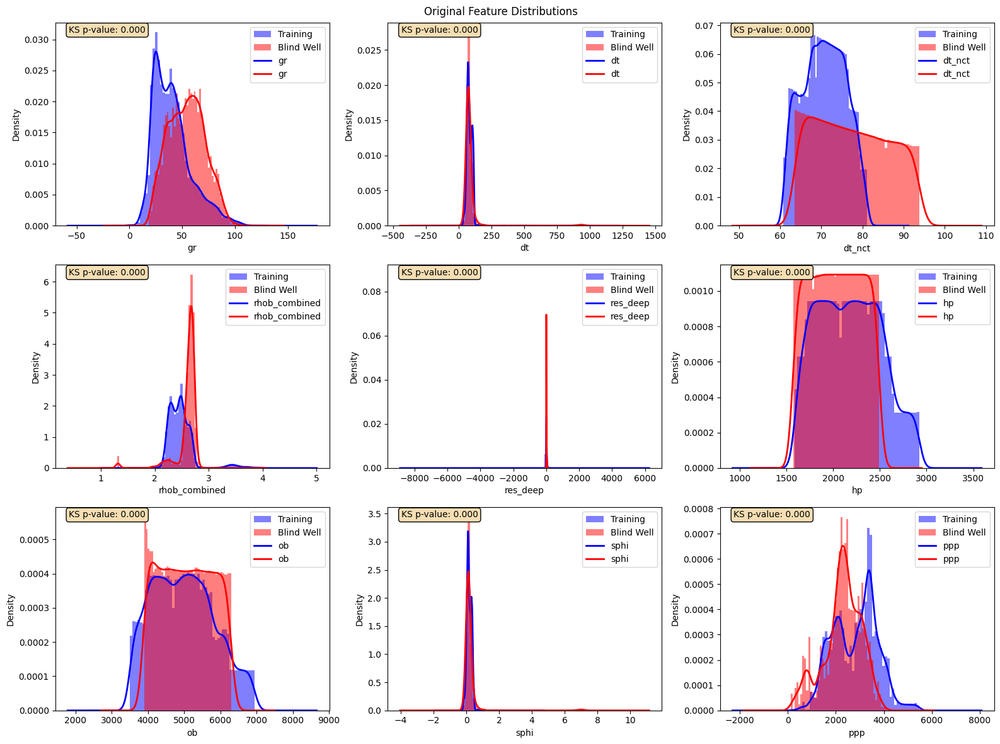


Statistical Comparison (Training vs Blind Well):
----------------------------------------------------------------------------------------------------
Feature              Train Mean   Blind Mean   Train Std    Blind Std    KS p-value  
----------------------------------------------------------------------------------------------------
gr                   40.68        54.36        17.92        16.91        0.0000      
dt                   83.73        86.23        22.36        82.01        0.0000      
dt_nct               70.72        77.70        5.08         8.73         0.0000      
rhob_combined        2.48         2.60         0.25         0.21         0.0000      
res_deep             20.18        15.55        85.09        12.56        0.0000      
hp                   2178.51      2032.43      332.72       264.73       0.0000      
ob                   4988.83      5065.73      846.62       703.27       0.0000      
sphi                 0.17         0.21         0.15         

In [3]:
# Function to plot distributions
def plot_distributions(train_data, blind_data, features, title="Feature Distributions"):
    n_features = len(features)
    fig, axes = plt.subplots(3, 3, figsize=(16, 12))
    axes = axes.ravel()
    
    for idx, feature in enumerate(features + [target_col]):
        if idx < len(axes):
            ax = axes[idx]
            
            # Plot histograms
            ax.hist(train_data[feature], bins=50, alpha=0.5, label='Training', density=True, color='blue')
            ax.hist(blind_data[feature], bins=50, alpha=0.5, label='Blind Well', density=True, color='red')
            
            # Add KDE
            train_data[feature].plot(kind='density', ax=ax, color='blue', linewidth=2)
            blind_data[feature].plot(kind='density', ax=ax, color='red', linewidth=2)
            
            ax.set_xlabel(feature)
            ax.set_ylabel('Density')
            ax.legend()
            
            # Add KS test p-value
            ks_stat, p_value = ks_2samp(train_data[feature], blind_data[feature])
            ax.text(0.05, 0.95, f'KS p-value: {p_value:.3f}', 
                    transform=ax.transAxes, bbox=dict(boxstyle='round', facecolor='wheat'))
    
    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

# Plot original distributions
plot_distributions(train_df_combined, blind_df, features, "Original Feature Distributions")

# Statistical comparison
print("\nStatistical Comparison (Training vs Blind Well):")
print("-" * 100)
print(f"{'Feature':<20} {'Train Mean':<12} {'Blind Mean':<12} {'Train Std':<12} {'Blind Std':<12} {'KS p-value':<12}")
print("-" * 100)

for feature in features + [target_col]:
    train_mean = train_df_combined[feature].mean()
    blind_mean = blind_df[feature].mean()
    train_std = train_df_combined[feature].std()
    blind_std = blind_df[feature].std()
    ks_stat, p_value = ks_2samp(train_df_combined[feature], blind_df[feature])
    
    print(f"{feature:<20} {train_mean:<12.2f} {blind_mean:<12.2f} {train_std:<12.2f} {blind_std:<12.2f} {p_value:<12.4f}")


Testing quantile transformation...
  Average KS statistic: 0.2537

Testing power transformation...
  Average KS statistic: 0.2537

Testing standard transformation...
  Average KS statistic: 0.2537

Best alignment method: quantile


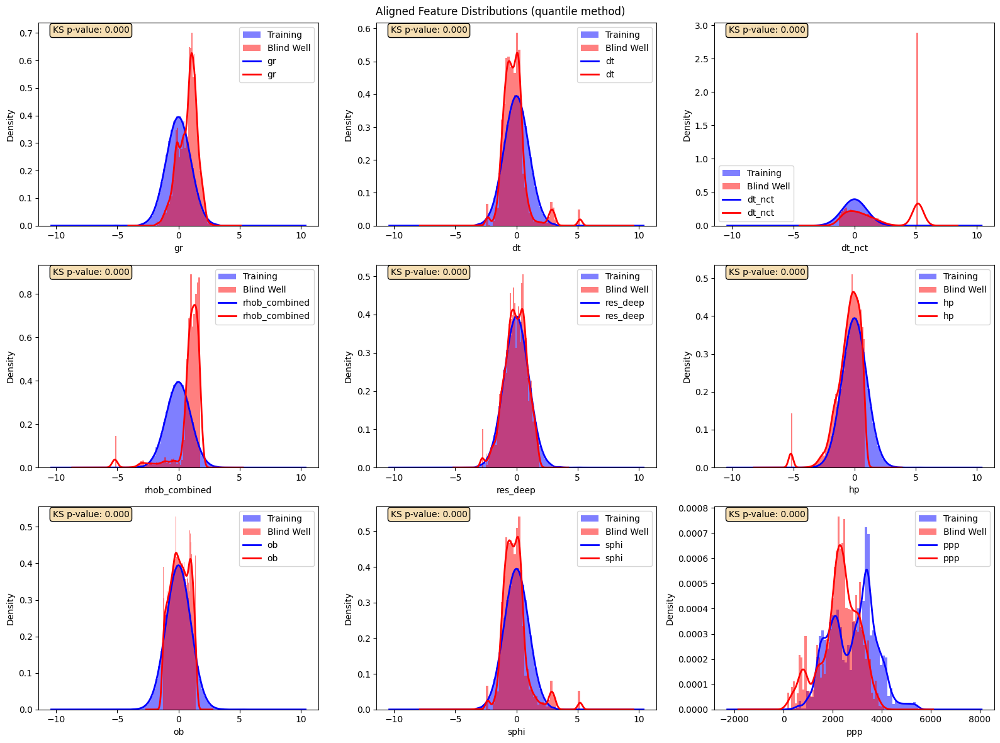

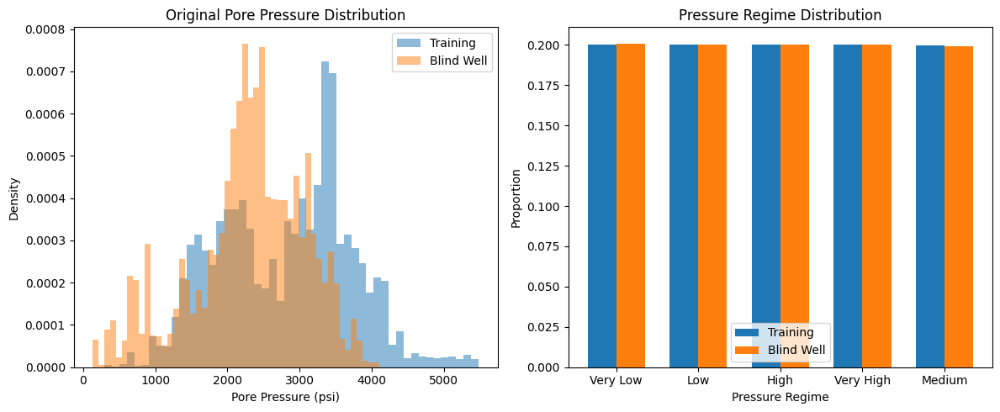


Pressure Distribution Analysis:
Training: Mean=2821.8, Std=916.7
Blind Well: Mean=2288.6, Std=783.6


In [5]:
class DistributionAligner:
    """Class to align distributions between training and test data"""
    
    def __init__(self, method='quantile'):
        self.method = method
        self.scalers = {}
        self.train_stats = {}
        
    def fit(self, train_data, features):
        """Fit the distribution alignment on training data"""
        for feature in features:
            if self.method == 'quantile':
                scaler = QuantileTransformer(n_quantiles=1000, subsample=int(1e6), 
                                           output_distribution='normal', random_state=42)
            elif self.method == 'power':
                scaler = PowerTransformer(method='yeo-johnson', standardize=True)
            elif self.method == 'standard':
                scaler = StandardScaler()
            else:
                raise ValueError(f"Unknown method: {self.method}")
            
            scaler.fit(train_data[[feature]])
            self.scalers[feature] = scaler
            
            # Store training statistics
            self.train_stats[feature] = {
                'mean': train_data[feature].mean(),
                'std': train_data[feature].std(),
                'min': train_data[feature].min(),
                'max': train_data[feature].max(),
                'q1': train_data[feature].quantile(0.25),
                'q3': train_data[feature].quantile(0.75)
            }
    
    def transform(self, data, features):
        """Transform data to align distributions"""
        transformed_data = data.copy()
        
        for feature in features:
            # Apply transformation
            transformed_data[feature] = self.scalers[feature].transform(data[[feature]]).flatten()
            
        return transformed_data
    
    def fit_transform(self, train_data, features):
        """Fit and transform in one step"""
        self.fit(train_data, features)
        return self.transform(train_data, features)

#Create separate scaler for target variable
class TargetScaler:
    """Domain-specific scaler for pore pressure"""
    def __init__(self):
        self.mean = None
        self.std = None
        
    def fit(self, y):
        self.mean = y.mean()
        self.std = y.std()
        return self
        
    def transform(self, y):
        return (y - self.mean) / self.std
        
    def inverse_transform(self, y_scaled):
        return y_scaled * self.std + self.mean

# Apply different alignment methods - EXCLUDING target variable
aligners = {
    'quantile': DistributionAligner('quantile'),
    'power': DistributionAligner('power'),
    'standard': DistributionAligner('standard')
}

# Test each alignment method
best_method = None
best_score = float('inf')

for method_name, aligner in aligners.items():
    print(f"\nTesting {method_name} transformation...")
    
    # Transform data - features only, not target
    train_aligned = aligner.fit_transform(train_df_combined, features)
    train_aligned[target_col] = train_df_combined[target_col]  
    train_aligned[depth_col] = train_df_combined[depth_col]    
    
    blind_aligned = aligner.transform(blind_df, features)
    blind_aligned[target_col] = blind_df[target_col] 
    blind_aligned[depth_col] = blind_df[depth_col]
    
    # Calculate alignment score (average KS statistic)
    ks_scores = []
    for feature in features:
        ks_stat, _ = ks_2samp(train_aligned[feature], blind_aligned[feature])
        ks_scores.append(ks_stat)
    
    avg_ks = np.mean(ks_scores)
    print(f"  Average KS statistic: {avg_ks:.4f}")
    
    if avg_ks < best_score:
        best_score = avg_ks
        best_method = method_name

print(f"\nBest alignment method: {best_method}")

# Use the best method
aligner = aligners[best_method]
train_df_aligned = aligner.fit_transform(train_df_combined, features)
train_df_aligned[target_col] = train_df_combined[target_col]  # Keep original target
train_df_aligned[depth_col] = train_df_combined[depth_col]    # Keep depth

blind_df_aligned = aligner.transform(blind_df, features)
blind_df_aligned[target_col] = blind_df[target_col]  # Keep original target
blind_df_aligned[depth_col] = blind_df[depth_col]    # Keep depth

# Create target scaler
target_scaler = TargetScaler()
target_scaler.fit(train_df_combined[target_col])

# Plot aligned distributions
plot_distributions(train_df_aligned, blind_df_aligned, features, 
                  f"Aligned Feature Distributions ({best_method} method)")

# Analyze pressure distribution separately
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

# Original pressure distribution
ax1.hist(train_df_combined[target_col], bins=50, alpha=0.5, density=True, label='Training')
ax1.hist(blind_df[target_col], bins=50, alpha=0.5, density=True, label='Blind Well')
ax1.set_xlabel('Pore Pressure (psi)')
ax1.set_ylabel('Density')
ax1.set_title('Original Pore Pressure Distribution')
ax1.legend()

# Pressure regime analysis
pressure_bins_train = pd.qcut(train_df_combined[target_col], q=5, labels=['Very Low', 'Low', 'Medium', 'High', 'Very High'])
pressure_bins_blind = pd.qcut(blind_df[target_col], q=5, labels=['Very Low', 'Low', 'Medium', 'High', 'Very High'])

train_counts = pressure_bins_train.value_counts(normalize=True)
blind_counts = pressure_bins_blind.value_counts(normalize=True)

x = np.arange(len(train_counts))
width = 0.35

ax2.bar(x - width/2, train_counts.values, width, label='Training')
ax2.bar(x + width/2, blind_counts.values, width, label='Blind Well')
ax2.set_xlabel('Pressure Regime')
ax2.set_ylabel('Proportion')
ax2.set_title('Pressure Regime Distribution')
ax2.set_xticks(x)
ax2.set_xticklabels(train_counts.index)
ax2.legend()

plt.tight_layout()
plt.savefig('pressure_distribution_analysis.png', dpi=300, bbox_inches='tight')
plt.show()

# Print pressure statistics
print("\nPressure Distribution Analysis:")
print(f"Training: Mean={train_df_combined[target_col].mean():.1f}, Std={train_df_combined[target_col].std():.1f}")
print(f"Blind Well: Mean={blind_df[target_col].mean():.1f}, Std={blind_df[target_col].std():.1f}")

In [6]:
# Split aligned data (keep your original simple split)
train_df, test_df = train_test_split(train_df_aligned, test_size=0.3, random_state=42)

# Also prepare blind well data
df_finetune, df_val = train_test_split(blind_df_aligned, test_size=0.85, random_state=42)

X_train = train_df[features].values
y_train = train_df[target_col].values
X_test = test_df[features].values
y_test = test_df[target_col].values

X_ft = df_finetune[features].values
y_ft = df_finetune[target_col].values
X_val = df_val[features].values
y_val = df_val[target_col].values

print(f"Training samples: {len(X_train)}")
print(f"Test samples: {len(X_test)}")
print(f"Fine-tune samples: {len(df_finetune)}")
print(f"Validation samples: {len(df_val)}")

# Scale data using StandardScaler as in original
scaler = StandardScaler()
X_train_s = scaler.fit_transform(X_train)
X_test_s = scaler.transform(X_test)
X_ft_s = scaler.transform(X_ft)
X_val_s = scaler.transform(X_val)

# Reshape for CNN
X_train_cnn = X_train_s.reshape(-1, len(features), 1)
X_test_cnn = X_test_s.reshape(-1, len(features), 1)
X_ft_cnn = X_ft_s.reshape(-1, len(features), 1)
X_val_cnn = X_val_s.reshape(-1, len(features), 1)

# Callbacks
es = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
rlr = ReduceLROnPlateau(monitor='val_loss', patience=5, factor=0.5, min_lr=1e-6)

# Your original evaluation function
def evaluate(name, y_true, y_pred):
    r2 = r2_score(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    rel = rmse/(y_true.max()-y_true.min())*100
    print(f"{name}: R²={r2:.4f}, RMSE={rmse:.2f}, MAE={mae:.2f}, RelRMSE={rel:.2f}%")

Training samples: 10352
Test samples: 4437
Fine-tune samples: 778
Validation samples: 4412


In [7]:
print("Training CNN...")
cnn = Sequential([
    Input((len(features),1)),
    
    # First Conv Block with regularization
    Conv1D(64, kernel_size=2, padding='same', activation='relu',
           kernel_regularizer=regularizers.L2(0.001)),
    BatchNormalization(),
    MaxPooling1D(pool_size=2),
    Dropout(0.25),
    
    # Second Conv Block  
    Conv1D(128, kernel_size=2, padding='same', activation='relu',
           kernel_regularizer=regularizers.L2(0.001)),
    BatchNormalization(),
    Dropout(0.25),
    
    Flatten(),
    
    # Dense layers with stronger regularization
    Dense(128, activation='relu',
          kernel_regularizer=regularizers.L2(0.002)),  
    BatchNormalization(),
    Dropout(0.4),
    
    Dense(64, activation='relu',                       
          kernel_regularizer=regularizers.L2(0.002)),
    BatchNormalization(), 
    Dropout(0.3),
    
    Dense(1)  
])

cnn.compile(optimizer='adam', loss='mse')
cnn.fit(X_train_cnn, y_train,
        validation_split=0.2,
        epochs=100, batch_size=32,
        callbacks=[es, rlr],
        verbose=1)
cnn.save('cnn_model_nosphi.h5')
y_pred_cnn = cnn.predict(X_test_cnn).flatten()
evaluate("CNN", y_test, y_pred_cnn)

Training CNN...
Epoch 1/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 8879088.0000 - val_loss: 8600957.0000 - learning_rate: 0.0010
Epoch 2/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - loss: 8748387.0000 - val_loss: 8329221.0000 - learning_rate: 0.0010
Epoch 3/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 8488307.0000 - val_loss: 7955220.5000 - learning_rate: 0.0010
Epoch 4/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - loss: 8106257.5000 - val_loss: 7598979.0000 - learning_rate: 0.0010
Epoch 5/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 7640043.5000 - val_loss: 7060218.0000 - learning_rate: 0.0010
Epoch 6/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - loss: 7107886.0000 - val_loss: 6432939.5000 - learning_rate: 0.0010
Epoch 7/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 6543610.5000 - val_loss: 5901782.0000 - learning_rate: 0.0010
Epoch 8/100
259/259 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 5951809.5000 - val_loss: 5297207.5000 - learning_rate: 0

139/139 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
CNN: R²=0.9233, RMSE=252.03, MAE=168.51, RelRMSE=4.86%


In [8]:
print("\nTraining DFNN...")
dfnn = Sequential([
    Dense(256, activation='relu', input_shape=(len(features),)),  
    BatchNormalization(),
    Dropout(0.2),  
    Dense(128, activation='relu'),
    BatchNormalization(),
    Dropout(0.2),
    Dense(64, activation='relu'),
    BatchNormalization(),
    Dropout(0.1),
    Dense(1)  
])
dfnn.compile(optimizer='adam', loss='mse')
dfnn.fit(X_train_s, y_train,
         validation_split=0.3,
         epochs=100, batch_size=32,
         callbacks=[es, rlr],
         verbose=1)
dfnn.save('dfnn_model_nosphi.h5')
y_pred_dfnn = dfnn.predict(X_test_s).flatten()
evaluate("DFNN", y_test, y_pred_dfnn)


Training DFNN...
Epoch 1/100
227/227 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 8818822.0000 - val_loss: 8560302.0000 - learning_rate: 0.0010
Epoch 2/100
227/227 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 8706066.0000 - val_loss: 8369647.0000 - learning_rate: 0.0010
Epoch 3/100
227/227 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 8493717.0000 - val_loss: 8085925.5000 - learning_rate: 0.0010
Epoch 4/100
227/227 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 8186291.0000 - val_loss: 7711851.0000 - learning_rate: 0.0010
Epoch 5/100
227/227 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 7799909.0000 - val_loss: 7338824.5000 - learning_rate: 0.0010
Epoch 6/100
227/227 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 7348829.0000 - val_loss: 6857769.0000 - learning_rate: 0.0010
Epoch 7/100
227/227 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 6869264.5000 - val_loss: 6406262.5000 - learning_rate: 0.0010
Epoch 8/100
227/227 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 6354023.5000 - val_loss: 5917415.0000 - learning_rate: 0.001

139/139 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
DFNN: R²=0.9264, RMSE=246.91, MAE=168.06, RelRMSE=4.76%


In [9]:
print("\nTraining RNN...")
# Reshape for RNN
X_train_rnn = X_train_s.reshape(-1, len(features), 1)
X_test_rnn = X_test_s.reshape(-1, len(features), 1)

def create_simple_rnn():
    model = Sequential([
        Input((len(features), 1)),
        LSTM(64, return_sequences=True),
        BatchNormalization(),
        Dropout(0.3),
        LSTM(32, return_sequences=False),
        BatchNormalization(),
        Dropout(0.3),
        Dense(64, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1)
    ])
    return model

rnn = create_simple_rnn()
rnn.compile(optimizer='adam', loss='mse', metrics=['mae'])
rnn.fit(X_train_rnn, y_train,
        validation_split=0.2,
        epochs=150,
        batch_size=16,
        callbacks=[es, rlr],
        verbose=1)
rnn.save('rnn_model_nosphi.h5')
y_pred_rnn = rnn.predict(X_test_rnn).flatten()
evaluate("RNN", y_test, y_pred_rnn)


Training RNN...
Epoch 1/150
518/518 ━━━━━━━━━━━━━━━━━━━━ 9s 8ms/step - loss: 8867990.0000 - mae: 2832.9631 - val_loss: 8567933.0000 - val_mae: 2789.7236 - learning_rate: 0.0010
Epoch 2/150
518/518 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 8462155.0000 - mae: 2780.3809 - val_loss: 7881728.0000 - val_mae: 2700.1685 - learning_rate: 0.0010
Epoch 3/150
518/518 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 7615754.5000 - mae: 2655.3926 - val_loss: 7171333.5000 - val_mae: 2595.7600 - learning_rate: 0.0010
Epoch 4/150
518/518 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 6529768.0000 - mae: 2474.6790 - val_loss: 5805679.5000 - val_mae: 2351.0322 - learning_rate: 0.0010
Epoch 5/150
518/518 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 5375334.0000 - mae: 2253.8367 - val_loss: 4648918.5000 - val_mae: 2112.6436 - learning_rate: 0.0010
Epoch 6/150
518/518 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 4235789.5000 - mae: 1999.3083 - val_loss: 3323066.2500 - val_mae: 1785.6239 - learning_rate: 0.0010
Epoch 7/150
518/5

139/139 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
RNN: R²=0.9176, RMSE=261.25, MAE=180.57, RelRMSE=5.04%


In [10]:
# Train Random Forest
print("\nTraining Random Forest...")
rf = RandomForestRegressor(
    n_estimators=500, max_depth=15,
    min_samples_split=5, min_samples_leaf=2,
    random_state=42, n_jobs=-1
)
rf.fit(X_train_s, y_train)
joblib.dump(rf, 'rf_model_nosphi.pkl')
y_pred_rf = rf.predict(X_test_s)
evaluate("Random Forest", y_test, y_pred_rf)

# Train XGBoost
print("\nTraining XGBoost...")
xgb_model = xgb.XGBRegressor(
    n_estimators=1000,
    max_depth=6,
    learning_rate=0.1,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42,
    early_stopping_rounds=10
)
xgb_model.fit(
    X_train_s, y_train,
    eval_set=[(X_test_s, y_test)],
    verbose=False
)
xgb_model.save_model('xgb_model_nosphi.json')
y_pred_xgb = xgb_model.predict(X_test_s)
evaluate("XGBoost", y_test, y_pred_xgb)

print("\n✅ All models trained and saved successfully!")


Training Random Forest...
Random Forest: R²=0.9962, RMSE=55.81, MAE=24.32, RelRMSE=1.08%

Training XGBoost...
XGBoost: R²=0.9963, RMSE=55.66, MAE=32.42, RelRMSE=1.07%

✅ All models trained and saved successfully!


In [11]:
print("=" * 80)
print("TESTING ON BLIND WELL (BEFORE FINE-TUNING)")
print("=" * 80)

# Test CNN
y_pred_cnn_original = cnn.predict(X_val_cnn).flatten()
print("\n🔮 CNN Blind Well Results (Before Fine-tuning):")
evaluate("CNN Original", y_val, y_pred_cnn_original)

# Test DFNN
y_pred_dfnn_original = dfnn.predict(X_val_s).flatten()
print("\n🔮 DFNN Blind Well Results (Before Fine-tuning):")
evaluate("DFNN Original", y_val, y_pred_dfnn_original)

# Test RNN
X_val_rnn = X_val_s.reshape(-1, len(features), 1)
y_pred_rnn_original = rnn.predict(X_val_rnn).flatten()
print("\n🔮 RNN Blind Well Results (Before Fine-tuning):")
evaluate("RNN Original", y_val, y_pred_rnn_original)

# Test RF
y_pred_rf_original = rf.predict(X_val_s)
print("\n🔮 Random Forest Blind Well Results (Before Fine-tuning):")
evaluate("RF Original", y_val, y_pred_rf_original)

# Test XGBoost
y_pred_xgb_original = xgb_model.predict(X_val_s)
print("\n🔮 XGBoost Blind Well Results (Before Fine-tuning):")
evaluate("XGBoost Original", y_val, y_pred_xgb_original)

TESTING ON BLIND WELL (BEFORE FINE-TUNING)
138/138 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

🔮 CNN Blind Well Results (Before Fine-tuning):
CNN Original: R²=-0.1717, RMSE=849.32, MAE=673.22, RelRMSE=21.38%
138/138 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

🔮 DFNN Blind Well Results (Before Fine-tuning):
DFNN Original: R²=-0.3520, RMSE=912.34, MAE=696.31, RelRMSE=22.96%
138/138 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

🔮 RNN Blind Well Results (Before Fine-tuning):
RNN Original: R²=-0.6129, RMSE=996.47, MAE=767.66, RelRMSE=25.08%

🔮 Random Forest Blind Well Results (Before Fine-tuning):
RF Original: R²=-0.2364, RMSE=872.46, MAE=690.41, RelRMSE=21.96%

🔮 XGBoost Blind Well Results (Before Fine-tuning):
XGBoost Original: R²=-0.1990, RMSE=859.16, MAE=639.47, RelRMSE=21.62%


In [12]:
print("\n" + "=" * 80)
print("FINE-TUNING ON BLIND WELL")
print("=" * 80)

# Prepare fine-tuning data reshapes
X_ft_rnn = X_ft_s.reshape(-1, len(features), 1)

# Fine-tune CNN
cnn_f = clone_model(cnn)
cnn_f.set_weights(cnn.get_weights())
cnn_f.compile(optimizer='adam', loss='mse')

cnn_f.fit(X_ft_cnn, y_ft,
          validation_data=(X_val_cnn, y_val),
          epochs=100, batch_size=16,
          callbacks=[es, rlr], verbose=1)

y_pred_cnn_finetuned = cnn_f.predict(X_val_cnn).flatten()
print("\n🔮 CNN Blind Well Results (After Fine-tuning):")
evaluate("CNN Fine-tuned", y_val, y_pred_cnn_finetuned)

# Fine-tune DFNN
dfnn_f = clone_model(dfnn)
dfnn_f.set_weights(dfnn.get_weights())
dfnn_f.compile(optimizer='adam', loss='mse')

dfnn_f.fit(X_ft_s, y_ft,
           validation_data=(X_val_s, y_val),
           epochs=100, batch_size=16,
           callbacks=[es, rlr], verbose=1)

y_pred_dfnn_finetuned = dfnn_f.predict(X_val_s).flatten()
print("\n🔮 DFNN Blind Well Results (After Fine-tuning):")
evaluate("DFNN Fine-tuned", y_val, y_pred_dfnn_finetuned)

# Fine-tune RNN
rnn_f = clone_model(rnn)
rnn_f.set_weights(rnn.get_weights())
rnn_f.compile(optimizer='adam', loss='mse')

rnn_f.fit(X_ft_rnn, y_ft,
          validation_data=(X_val_rnn, y_val),
          epochs=100, batch_size=16,
          callbacks=[es, rlr], verbose=1)

y_pred_rnn_finetuned = rnn_f.predict(X_val_rnn).flatten()
print("\n🔮 RNN Blind Well Results (After Fine-tuning):")
evaluate("RNN Fine-tuned", y_val, y_pred_rnn_finetuned)

# Fine-tune RF
rf_f = RandomForestRegressor(
    n_estimators=500, max_depth=15,
    min_samples_split=5, min_samples_leaf=2,
    random_state=42, n_jobs=-1
)
rf_f.fit(X_ft_s, y_ft)

y_pred_rf_finetuned = rf_f.predict(X_val_s)
print("\n🔮 Random Forest Blind Well Results (After Fine-tuning):")
evaluate("RF Fine-tuned", y_val, y_pred_rf_finetuned)

# Fine-tune XGBoost
xgb_f = xgb.XGBRegressor(
    n_estimators=1000,
    max_depth=6,
    learning_rate=0.01,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42,
    early_stopping_rounds=10
)
xgb_f.fit(
    X_ft_s, y_ft,
    eval_set=[(X_val_s, y_val)],
    verbose=False
)

y_pred_xgb_finetuned = xgb_f.predict(X_val_s)
print("\n🔮 XGBoost Blind Well Results (After Fine-tuning):")
evaluate("XGBoost Fine-tuned", y_val, y_pred_xgb_finetuned)


FINE-TUNING ON BLIND WELL
Epoch 1/100
49/49 ━━━━━━━━━━━━━━━━━━━━ 5s 37ms/step - loss: 1089578.1250 - val_loss: 438614.8125 - learning_rate: 0.0010
Epoch 2/100
49/49 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - loss: 741147.3750 - val_loss: 426061.8125 - learning_rate: 0.0010
Epoch 3/100
49/49 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - loss: 660551.4375 - val_loss: 416424.1250 - learning_rate: 0.0010
Epoch 4/100
49/49 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - loss: 614084.7500 - val_loss: 401833.5312 - learning_rate: 0.0010
Epoch 5/100
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step - loss: 546911.6875 - val_loss: 370586.2188 - learning_rate: 0.0010
Epoch 6/100
49/49 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step - loss: 502495.5625 - val_loss: 349367.1562 - learning_rate: 0.0010
Epoch 7/100
49/49 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - loss: 478557.3750 - val_loss: 337433.1250 - learning_rate: 0.0010
Epoch 8/100
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - loss: 460806.9688 - val_loss: 316541.9688 - learning_rate: 0.0010
Epoch 9/100


In [13]:
print("\n" + "="*60)
print("SUMMARY: Model Performance on Blind Well (85% validation set)")
print("="*60)

results = {
    'Model': ['CNN', 'DFNN', 'RNN', 'Random Forest', 'XGBoost'],
    'Before Fine-tuning': [
        r2_score(y_val, y_pred_cnn_original),
        r2_score(y_val, y_pred_dfnn_original),
        r2_score(y_val, y_pred_rnn_original),
        r2_score(y_val, y_pred_rf_original),
        r2_score(y_val, y_pred_xgb_original)
    ],
    'After Fine-tuning': [
        r2_score(y_val, y_pred_cnn_finetuned),
        r2_score(y_val, y_pred_dfnn_finetuned),
        r2_score(y_val, y_pred_rnn_finetuned),
        r2_score(y_val, y_pred_rf_finetuned),
        r2_score(y_val, y_pred_xgb_finetuned)
    ]
}

for i in range(len(results['Model'])):
    improvement = results['After Fine-tuning'][i] - results['Before Fine-tuning'][i]
    print(f"{results['Model'][i]:15} | Before: {results['Before Fine-tuning'][i]:.4f} | "
          f"After: {results['After Fine-tuning'][i]:.4f} | "
          f"Improvement: {improvement:+.4f}")

# Meta-Model Implementation
from sklearn.linear_model import Ridge

class MetaModel:
    def __init__(self, models, model_names):
        self.models = models
        self.model_names = model_names
        self.weights = None
        self.stacking_model = None

    def get_predictions(self, X_dict):
        """Get predictions from all base models"""
        predictions = {}
        predictions['CNN'] = self.models['CNN'].predict(X_dict['CNN']).flatten()
        predictions['DFNN'] = self.models['DFNN'].predict(X_dict['DFNN']).flatten()
        predictions['RNN'] = self.models['RNN'].predict(X_dict['RNN']).flatten()
        predictions['Random Forest'] = self.models['Random Forest'].predict(X_dict['RF']).flatten()
        predictions['XGBoost'] = self.models['XGBoost'].predict(X_dict['XGB']).flatten()
        return predictions

    def simple_average(self, predictions):
        pred_array = np.column_stack([predictions[name] for name in self.model_names])
        return np.mean(pred_array, axis=1)

    def weighted_average(self, predictions, weights=None):
        if weights is None:
            weights = self.weights
        pred_array = np.column_stack([predictions[name] for name in self.model_names])
        return np.average(pred_array, axis=1, weights=weights)

    def fit_stacking(self, X_dict, y_true, cv_folds=5):
        predictions = self.get_predictions(X_dict)
        pred_array = np.column_stack([predictions[name] for name in self.model_names])

        self.stacking_model = Ridge(alpha=1.0)
        self.stacking_model.fit(pred_array, y_true)

        scores = []
        for name in self.model_names:
            score = r2_score(y_true, predictions[name])
            scores.append(max(0, score))  

        total_score = sum(scores)
        if total_score == 0:
            self.weights = [1/len(scores)] * len(scores)  
        else:
            self.weights = [s / total_score for s in scores]

        print("Model Weights (based on R² scores):")
        for name, weight in zip(self.model_names, self.weights):
            print(f"  {name}: {weight:.3f}")

        return self

    def predict(self, X_dict, method='stacking'):
        predictions = self.get_predictions(X_dict)

        if method == 'simple':
            return self.simple_average(predictions)
        elif method == 'weighted':
            return self.weighted_average(predictions)
        elif method == 'stacking':
            pred_array = np.column_stack([predictions[name] for name in self.model_names])
            return self.stacking_model.predict(pred_array)
        else:
            raise ValueError(f"Unknown method: {method}")

print("\nCreating Meta-Model Ensemble...")

models = {
    'CNN': cnn_f,
    'DFNN': dfnn_f,
    'RNN': rnn_f,
    'Random Forest': rf_f,
    'XGBoost': xgb_f
}

model_names = ['CNN', 'DFNN', 'RNN', 'Random Forest', 'XGBoost']

X_ft_dict = {
    'CNN': X_ft_cnn,
    'DFNN': X_ft_s,
    'RNN': X_ft_rnn,
    'RF': X_ft_s,
    'XGB': X_ft_s
}

X_val_dict = {
    'CNN': X_val_cnn,
    'DFNN': X_val_s,
    'RNN': X_val_rnn,
    'RF': X_val_s,
    'XGB': X_val_s
}

meta_model = MetaModel(models, model_names)
meta_model.fit_stacking(X_ft_dict, y_ft)

y_pred_simple = meta_model.predict(X_val_dict, method='simple')
y_pred_weighted = meta_model.predict(X_val_dict, method='weighted')
y_pred_stacking = meta_model.predict(X_val_dict, method='stacking')

print("\n🔮 Meta-Model Results on Blind Well:")
evaluate("Simple Average", y_val, y_pred_simple)
evaluate("Weighted Average", y_val, y_pred_weighted)
evaluate("Stacking", y_val, y_pred_stacking)


SUMMARY: Model Performance on Blind Well (85% validation set)
CNN             | Before: -0.1717 | After: 0.6827 | Improvement: +0.8543
DFNN            | Before: -0.3520 | After: 0.6868 | Improvement: +1.0388
RNN             | Before: -0.6129 | After: 0.6827 | Improvement: +1.2956
Random Forest   | Before: -0.2364 | After: 0.8473 | Improvement: +1.0837
XGBoost         | Before: -0.1990 | After: 0.9113 | Improvement: +1.1103

Creating Meta-Model Ensemble...
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Model Weights (based on R² scores):
  CNN: 0.179
  DFNN: 0.182
  RNN: 0.182
  Random Forest: 0.226
  XGBoost: 0.231
138/138 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
138/138 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
138/138 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
138/138 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
138/138 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
138/138 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
138/138 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
138/138 ━━━━━━━━━━

138/138 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
138/138 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
138/138 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


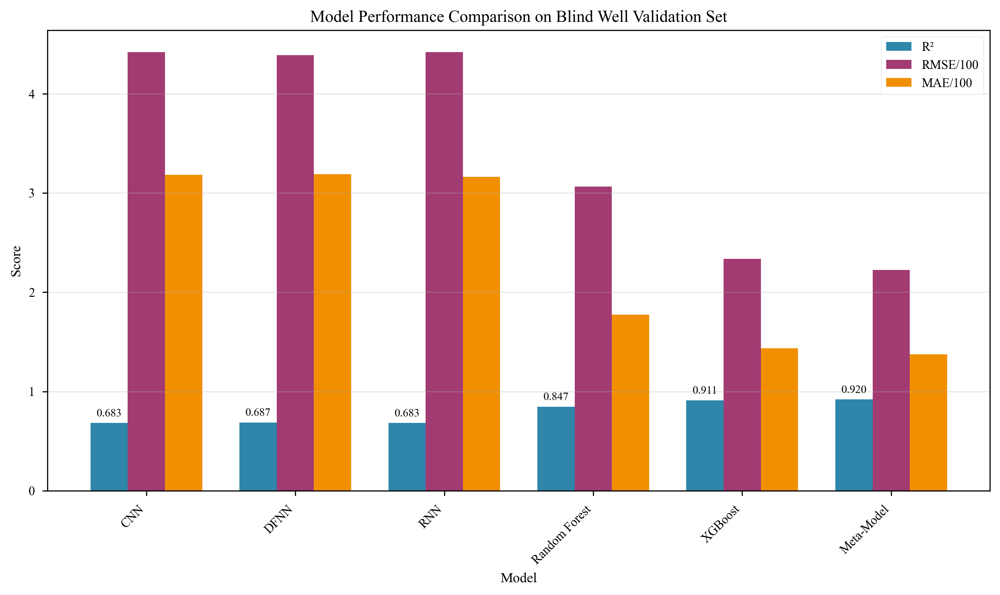

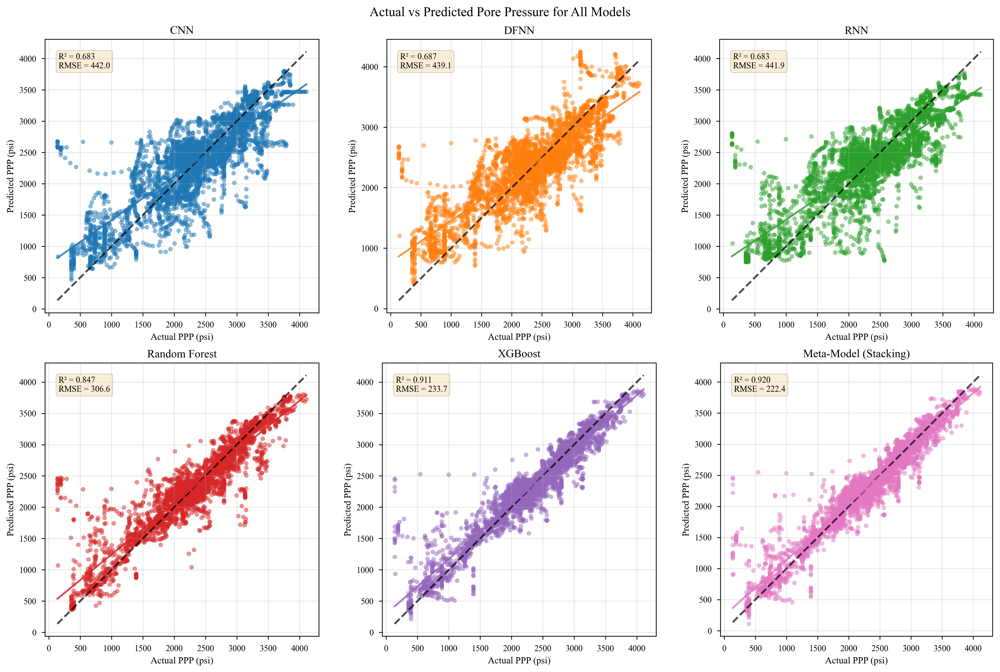

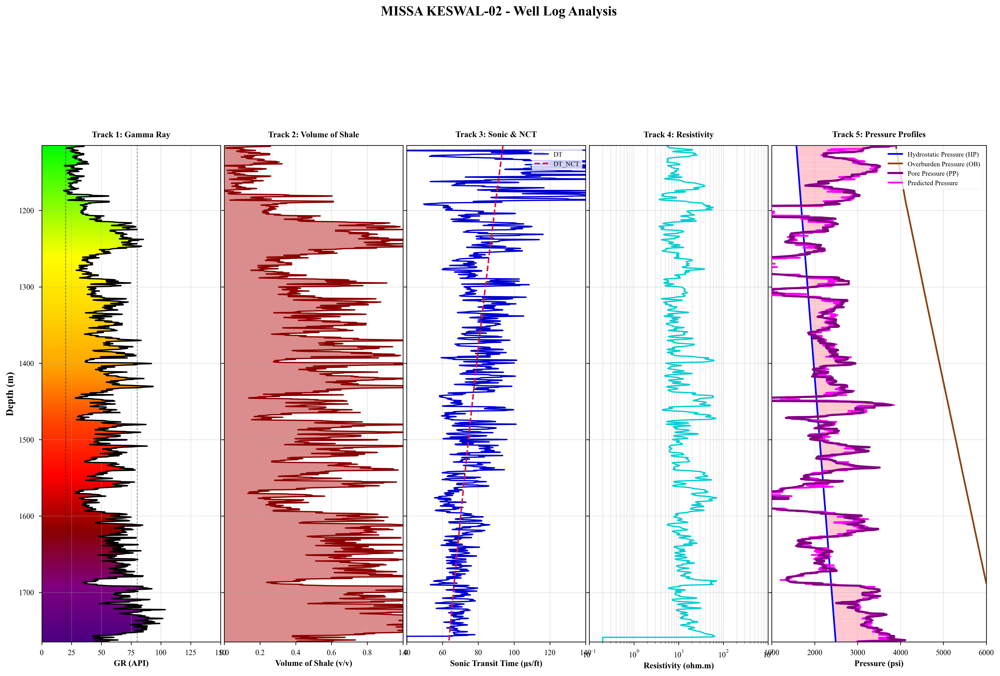


Well: MISSA KESWAL-02
Depth range: 1115.0 - 1764.8 m
Number of data points: 4412

Pressure statistics:
  Hydrostatic: 1573.7 - 2490.3 psi
  Pore Pressure: 136.4 - 4109.7 psi
  Overburden: 3895.2 - 6295.7 psi
  Predicted: 110.1 - 3896.2 psi

Pressure zone analysis:
  Overpressure zones: 2996 (67.9%)
  Normal/Underpressure zones: 1416 (32.1%)

FINAL SUMMARY STATISTICS
        Model     R²   RMSE    MAE MAPE (%)
          CNN 0.6827 442.01 318.42    26.94
         DFNN 0.6868 439.09 319.14    27.49
          RNN 0.6827 441.95 316.29    27.31
Random Forest 0.8473 306.64 177.61    18.14
      XGBoost 0.9113 233.70 143.60    13.79
   Meta-Model 0.9196 222.43 137.32    12.78

Best performing model: Meta-Model

✅ All visualizations and analysis completed successfully!


In [14]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.signal import savgol_filter
from matplotlib.gridspec import GridSpec
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.patches import Polygon

# Set plot style
plt.style.use('seaborn-v0_8-paper')
plt.rcParams.update({
    'figure.dpi': 300,
    'savefig.dpi': 300,
    'font.size': 10,
    'axes.labelsize': 10,
    'axes.titlesize': 12,
    'xtick.labelsize': 9,
    'ytick.labelsize': 9,
    'legend.fontsize': 9,
    'figure.figsize': (8, 6),
    'font.family': 'serif',
    'font.serif': ['Times New Roman']
})

# Define consistent color palette
colors = {
    'CNN': '#1f77b4',
    'DFNN': '#ff7f0e',
    'RNN': '#2ca02c',
    'Random Forest': '#d62728',
    'XGBoost': '#9467bd',
    'Meta-Model': '#e377c2'
}

# Get individual predictions for visualization
individual_predictions = meta_model.get_predictions(X_val_dict)

# ============================================
# Figure 1: Model Performance Comparison
# ============================================
fig, ax = plt.subplots(figsize=(10, 6))

model_names_all = model_names + ['Meta-Model']

r2_scores = [r2_score(y_val, individual_predictions[name]) for name in model_names]
r2_scores.append(r2_score(y_val, y_pred_stacking))

rmse_scores = [np.sqrt(mean_squared_error(y_val, individual_predictions[name])) for name in model_names]
rmse_scores.append(np.sqrt(mean_squared_error(y_val, y_pred_stacking)))

mae_scores = [mean_absolute_error(y_val, individual_predictions[name]) for name in model_names]
mae_scores.append(mean_absolute_error(y_val, y_pred_stacking))

x = np.arange(len(model_names_all))
width = 0.25

bars1 = ax.bar(x - width, r2_scores, width, label='R²', color='#2E86AB')
bars2 = ax.bar(x, np.array(rmse_scores)/100, width, label='RMSE/100', color='#A23B72')
bars3 = ax.bar(x + width, np.array(mae_scores)/100, width, label='MAE/100', color='#F18F01')

ax.set_xlabel('Model')
ax.set_ylabel('Score')
ax.set_title('Model Performance Comparison on Blind Well Validation Set')
ax.set_xticks(x)
ax.set_xticklabels(model_names_all, rotation=45, ha='right')
ax.legend()
ax.grid(True, alpha=0.3, axis='y')

for bars in [bars1]:
    for bar, score in zip(bars, r2_scores):
        height = bar.get_height()
        ax.annotate(f'{score:.3f}',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3),
                    textcoords="offset points",
                    ha='center', va='bottom',
                    fontsize=8)

plt.tight_layout()
plt.savefig('model_performance_comparison.png', dpi=300, bbox_inches='tight')
plt.show()

# ============================================
# Figure 2: Prediction Scatter Plots
# ============================================
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.ravel()

for idx, (name, pred) in enumerate(individual_predictions.items()):
    ax = axes[idx]
    
    r2 = r2_score(y_val, pred)
    rmse = np.sqrt(mean_squared_error(y_val, pred))
    
    ax.scatter(y_val, pred, alpha=0.5, s=20, color=colors[name], edgecolors=None)
    
    min_val, max_val = y_val.min(), y_val.max()
    ax.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2, alpha=0.7)
    
    z = np.polyfit(y_val, pred, 1)
    p = np.poly1d(z)
    x_line = np.linspace(min_val, max_val, 100)
    ax.plot(x_line, p(x_line), "-", color=colors[name], lw=2, alpha=0.8)
    
    ax.set_xlabel('Actual PPP (psi)')
    ax.set_ylabel('Predicted PPP (psi)')
    ax.set_title(f'{name}')
    
    textstr = f'R² = {r2:.3f}\nRMSE = {rmse:.1f}'
    ax.text(0.05, 0.95, textstr, transform=ax.transAxes, fontsize=9,
            verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))
    
    ax.set_aspect('equal', adjustable='box')
    ax.grid(True, alpha=0.3)

# Meta-model in the last subplot
ax = axes[5]
ax.scatter(y_val, y_pred_stacking, alpha=0.5, s=20, color=colors['Meta-Model'], edgecolors=None)
ax.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2, alpha=0.7)
z = np.polyfit(y_val, y_pred_stacking, 1)
p = np.poly1d(z)
ax.plot(x_line, p(x_line), "-", color=colors['Meta-Model'], lw=2, alpha=0.8)
ax.set_xlabel('Actual PPP (psi)')
ax.set_ylabel('Predicted PPP (psi)')
ax.set_title('Meta-Model (Stacking)')
r2 = r2_score(y_val, y_pred_stacking)
rmse = np.sqrt(mean_squared_error(y_val, y_pred_stacking))
textstr = f'R² = {r2:.3f}\nRMSE = {rmse:.1f}'
ax.text(0.05, 0.95, textstr, transform=ax.transAxes, fontsize=9,
        verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))
ax.set_aspect('equal', adjustable='box')
ax.grid(True, alpha=0.3)

plt.suptitle('Actual vs Predicted Pore Pressure for All Models', fontsize=14)
plt.tight_layout()
plt.savefig('prediction_scatter_plots.png', dpi=300, bbox_inches='tight')
plt.show()

# ============================================
# Figure 3: 5-Track Well Log Visualization
# ============================================
# Get validation indices from the aligned data
val_indices = df_val.index

# Create a dataframe with original values but aligned predictions
df_well = blind_df.loc[val_indices].copy()
df_well['predicted_pressure'] = y_pred_stacking

# Check if well column exists
if 'well' in df_well.columns or 'well_name' in df_well.columns:
    well_column = 'well' if 'well' in df_well.columns else 'well_name'
    print("Available wells:", df_well[well_column].unique())
    target_well = df_well[well_column].unique()[0]  
    df_well = df_well[df_well[well_column] == target_well].copy()
    well_name = target_well
else:
    well_name = "MISSA KESWAL-02"

# Sort by depth
df_well_sorted = df_well.sort_values('depth').reset_index(drop=True)

# Calculate Volume of Shale (Vsh) from GR if not present
if 'vsh' not in df_well_sorted.columns:
    gr_clean = 20  
    gr_shale = 80  
    df_well_sorted['vsh'] = (df_well_sorted['gr'] - gr_clean) / (gr_shale - gr_clean)
    df_well_sorted['vsh'] = df_well_sorted['vsh'].clip(0, 1)

# Extract data for plotting
depth = df_well_sorted['depth'].values

# Create the figure
fig = plt.figure(figsize=(20, 12))
gs = GridSpec(2, 5, height_ratios=[0.05, 1], width_ratios=[1, 1, 1, 1, 1.2], 
              wspace=0.02, hspace=0.3)

# Create custom colormap for GR
colors_gr = ['#00FF00', '#7FFF00', '#FFFF00', '#FFD700', '#FFA500', 
             '#FF4500', '#FF0000', '#8B0000', '#800080', '#4B0082']
n_bins = 256
gr_cmap = LinearSegmentedColormap.from_list('gr_lithology', colors_gr, N=n_bins)

# Clear all top row cells 
for i in range(5):
    ax_temp = fig.add_subplot(gs[0, i])
    ax_temp.axis('off')

# Set common depth range
depth_min, depth_max = depth.min(), depth.max()

# Track 1: Gamma Ray
ax1 = fig.add_subplot(gs[1, 0])
gr = df_well_sorted['gr'].values

# Create vertical gradient
n_depth_steps = 1000 
depth_array = np.linspace(depth_min, depth_max, n_depth_steps)
depth_normalized = (depth_array - depth_min) / (depth_max - depth_min)
gradient_2d = np.tile(depth_normalized.reshape(-1, 1), (1, 2))

gradient_image = ax1.imshow(gradient_2d, extent=[0, 150, depth_max, depth_min], 
                           aspect='auto', cmap=gr_cmap, alpha=1.0, zorder=1)

# Create polygon mask
vertices = []
for i in range(len(depth)):
    vertices.append((gr[i], depth[i]))
for i in range(len(depth)-1, -1, -1):
    vertices.append((0, depth[i]))

poly = Polygon(vertices, closed=True, facecolor='none', edgecolor='none')
ax1.add_patch(poly)
gradient_image.set_clip_path(poly)

ax1.plot(gr, depth, color='black', linewidth=1.5, zorder=3)

gr_clean = 20
gr_shale = 80

ax1.set_xlim(0, 150)
ax1.set_ylim(depth_max, depth_min)
ax1.set_xlabel('GR (API)', fontsize=10, fontweight='bold')
ax1.set_ylabel('Depth (m)', fontsize=12, fontweight='bold')
ax1.grid(True, alpha=0.3, zorder=2)
ax1.set_title('Track 1: Gamma Ray', fontsize=10, fontweight='bold', pad=10)
ax1.axvline(x=gr_clean, color='black', linestyle='--', alpha=0.5, linewidth=0.8, zorder=2)
ax1.axvline(x=gr_shale, color='black', linestyle='--', alpha=0.5, linewidth=0.8, zorder=2)

# Track 2: Volume of Shale
ax2 = fig.add_subplot(gs[1, 1])
vsh = df_well_sorted['vsh'].values

ax2.plot(vsh, depth, color='#8B0000', linewidth=1.5)
ax2.fill_betweenx(depth, 0, vsh, where=(vsh >= 0), interpolate=True, 
                  color='#CD5C5C', alpha=0.7)

ax2.set_xlim(0, 1)
ax2.set_ylim(depth_max, depth_min)
ax2.set_xlabel('Volume of Shale (v/v)', fontsize=10, fontweight='bold')
ax2.grid(True, alpha=0.3)
ax2.set_title('Track 2: Volume of Shale', fontsize=10, fontweight='bold', pad=10)
ax2.set_yticklabels([])

# Track 3: Sonic & NCT
ax3 = fig.add_subplot(gs[1, 2])
dt = df_well_sorted['dt'].values
dt_nct = df_well_sorted['dt_nct'].values

ax3.plot(dt, depth, color='#0000CD', linewidth=1.5, label='DT', zorder=2)
ax3.plot(dt_nct, depth, color='#DC143C', linewidth=1.8, label='DT_NCT', 
         linestyle='--', zorder=3)

ax3.set_xlim(40, 140)
ax3.set_ylim(depth_max, depth_min)
ax3.set_xlabel('Sonic Transit Time (μs/ft)', fontsize=10, fontweight='bold')
ax3.grid(True, alpha=0.3)
ax3.set_title('Track 3: Sonic & NCT', fontsize=10, fontweight='bold', pad=10)
ax3.legend(loc='upper right', fontsize=8)
ax3.set_yticklabels([])

# Track 4: Resistivity
ax4 = fig.add_subplot(gs[1, 3])
if 'res_deep' in df_well_sorted.columns:
    res = df_well_sorted['res_deep'].values
    ax4.semilogx(res, depth, color='#00CED1', linewidth=1.5)
    ax4.set_xlim(0.1, 1000)
else:
    ax4.text(0.5, (depth_min + depth_max) / 2, 'Resistivity Data Not Available', 
             rotation=90, va='center', ha='center', fontsize=12, color='gray')

ax4.set_ylim(depth_max, depth_min)
ax4.set_xlabel('Resistivity (ohm.m)', fontsize=10, fontweight='bold')
ax4.grid(True, alpha=0.3, which='both')
ax4.set_title('Track 4: Resistivity', fontsize=10, fontweight='bold', pad=10)
ax4.set_yticklabels([])

# Track 5: Pressure Profiles
ax5 = fig.add_subplot(gs[1, 4])

hp = df_well_sorted['hp'].values
ob = df_well_sorted['ob'].values
ppp = df_well_sorted['ppp'].values
predicted_pressure = df_well_sorted['predicted_pressure'].values

# Fill overpressure zones
for i in range(len(depth)-1):
    if ppp[i] > hp[i]:
        ax5.fill_betweenx([depth[i], depth[i+1]], hp[i], ppp[i], 
                          color='#FFB6C1', alpha=0.3, zorder=1) 

ax5.plot(hp, depth, color='#0000FF', linewidth=2, label='Hydrostatic Pressure (HP)', zorder=3)
ax5.plot(ob, depth, color='#8B4513', linewidth=2, label='Overburden Pressure (OB)', zorder=3)
ax5.plot(ppp, depth, color='#800080', linewidth=2.5, label='Pore Pressure (PP)', zorder=4)
ax5.plot(predicted_pressure, depth, color='#FF00FF', linewidth=2, 
         label='Predicted Pressure', linestyle='-', zorder=3)

ax5.set_xlim(1000, 6000)
ax5.set_ylim(depth_max, depth_min)
ax5.set_xlabel('Pressure (psi)', fontsize=10, fontweight='bold')
ax5.grid(True, alpha=0.3, zorder=0)
ax5.set_title('Track 5: Pressure Profiles', fontsize=10, fontweight='bold', pad=10)
ax5.legend(loc='upper right', fontsize=8)
ax5.set_yticklabels([])

fig.suptitle(f'{well_name} - Well Log Analysis', fontsize=16, fontweight='bold', y=0.98)
plt.tight_layout()
plt.subplots_adjust(top=0.93, hspace=0.3)
plt.savefig(f'{well_name}_well_log.png', dpi=300, bbox_inches='tight')
plt.show()

# Print statistics
print(f"\nWell: {well_name}")
print(f"Depth range: {depth_min:.1f} - {depth_max:.1f} m")
print(f"Number of data points: {len(depth)}")
print(f"\nPressure statistics:")
print(f"  Hydrostatic: {hp.min():.1f} - {hp.max():.1f} psi")
print(f"  Pore Pressure: {ppp.min():.1f} - {ppp.max():.1f} psi")
print(f"  Overburden: {ob.min():.1f} - {ob.max():.1f} psi")
print(f"  Predicted: {predicted_pressure.min():.1f} - {predicted_pressure.max():.1f} psi")

# Calculate overpressure zones
overpressure_count = np.sum(ppp > hp)
normal_pressure_count = np.sum(ppp <= hp)

print(f"\nPressure zone analysis:")
print(f"  Overpressure zones: {overpressure_count} ({overpressure_count/len(depth)*100:.1f}%)")
print(f"  Normal/Underpressure zones: {normal_pressure_count} ({normal_pressure_count/len(depth)*100:.1f}%)")

# ============================================
# Summary Statistics Table
# ============================================
print("\n" + "="*60)
print("FINAL SUMMARY STATISTICS")
print("="*60)

summary_data = []
for name in model_names + ['Meta-Model']:
    pred = y_pred_stacking if name == 'Meta-Model' else individual_predictions[name]
    
    r2 = r2_score(y_val, pred)
    rmse = np.sqrt(mean_squared_error(y_val, pred))
    mae = mean_absolute_error(y_val, pred)
    mape = np.mean(np.abs((y_val - pred) / y_val)) * 100
    
    summary_data.append({
        'Model': name,
        'R²': f"{r2:.4f}",
        'RMSE': f"{rmse:.2f}",
        'MAE': f"{mae:.2f}",
        'MAPE (%)': f"{mape:.2f}"
    })

summary_df = pd.DataFrame(summary_data)
print(summary_df.to_string(index=False))
print("\nBest performing model:", summary_df.loc[summary_df['R²'].astype(float).idxmax(), 'Model'])

# Save summary table
summary_df.to_csv('model_performance_summary.csv', index=False)
print("\n✅ All visualizations and analysis completed successfully!")

Reloading training wells with DST data...
  QAZIAN -1X.CSV: 5664 samples
    DST data points: 4
  MISSA KESWAL-01.CSV: 4364 samples
  MISSA KESWAL-03.CSV: 4761 samples


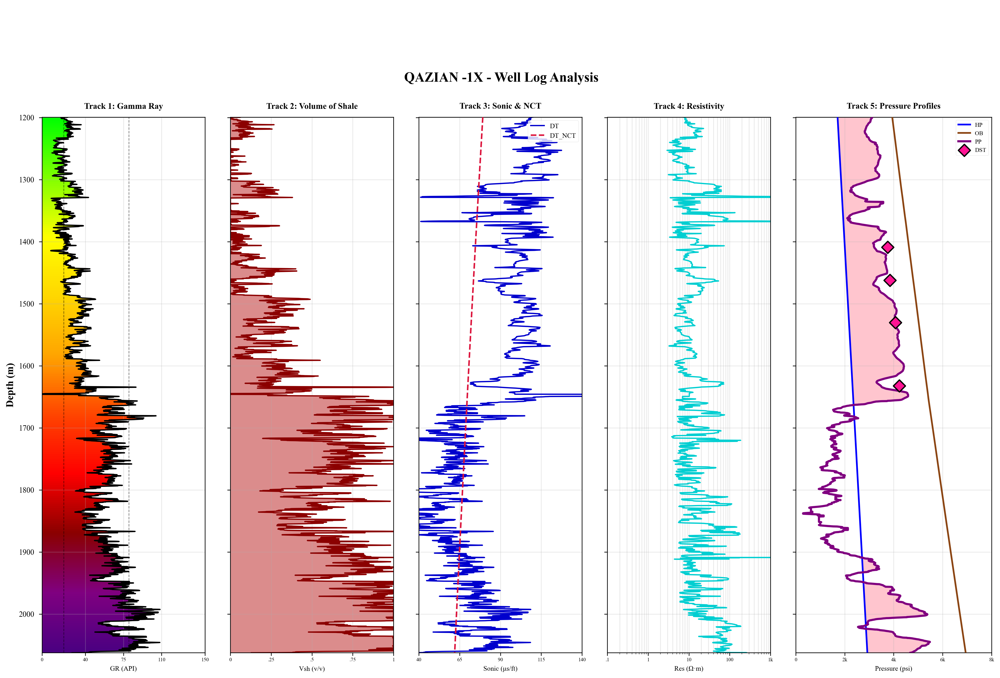


Well: QAZIAN -1X
Depth range: 1199.4 - 2062.4 m
Number of data points: 5664

Pressure statistics:
  Hydrostatic: 1705.1 - 2922.7 psi
  Pore Pressure: 293.4 - 5480.2 psi
  Overburden: 3939.7 - 6943.7 psi

DST Data:
  Number of DST points: 4
  DST values: [3757. 3844. 4073. 4230.]
  DST depths: [1409.0672 1462.4072 1530.3776 1632.1808]

Pressure zone analysis:
  Overpressure zones: 3932 (69.4%)
  Normal/Underpressure zones: 1732 (30.6%)


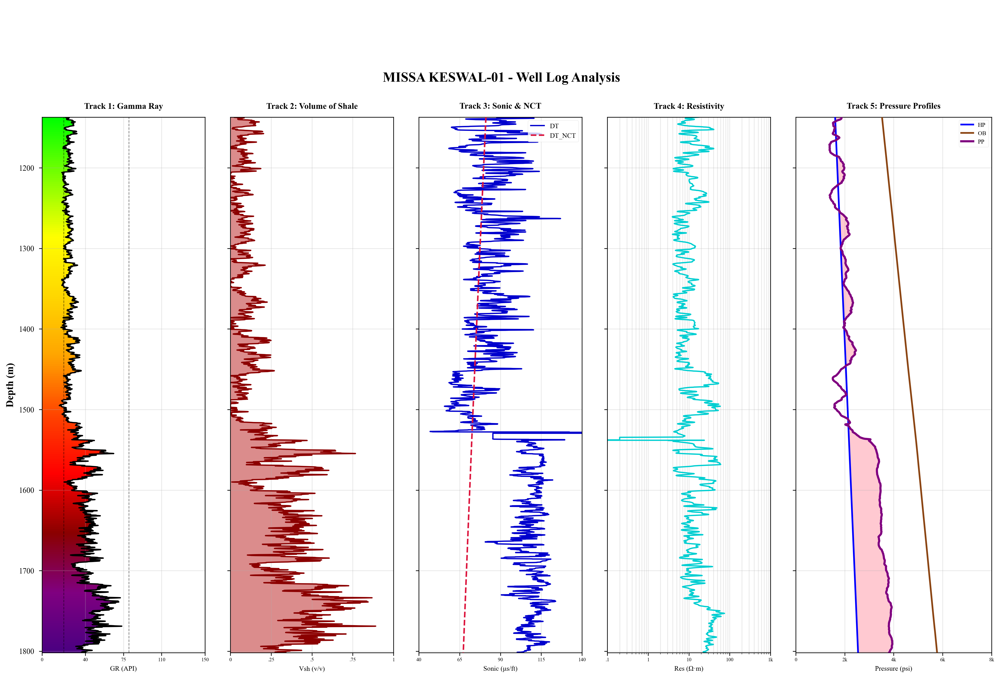


Well: MISSA KESWAL-01
Depth range: 1137.0 - 1802.0 m
Number of data points: 4364

Pressure statistics:
  Hydrostatic: 1605.3 - 2543.4 psi
  Pore Pressure: 1371.3 - 3943.5 psi
  Overburden: 3522.9 - 5774.1 psi

Pressure zone analysis:
  Overpressure zones: 3431 (78.6%)
  Normal/Underpressure zones: 933 (21.4%)


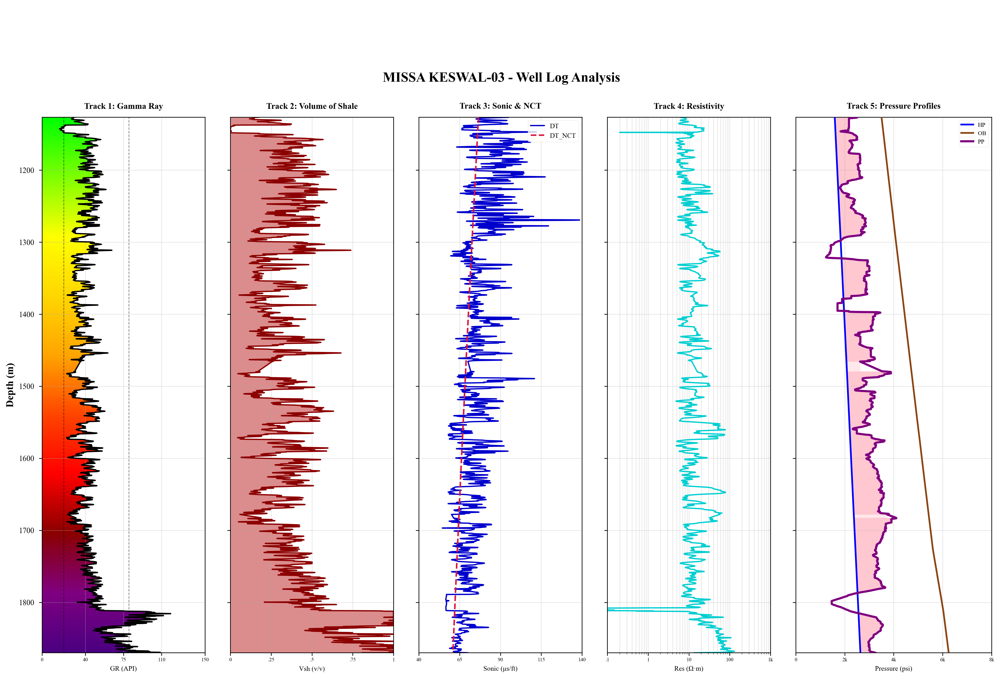


Well: MISSA KESWAL-03
Depth range: 1126.5 - 1869.9 m
Number of data points: 4761

Pressure statistics:
  Hydrostatic: 1589.5 - 2638.2 psi
  Pore Pressure: 1233.8 - 4108.4 psi
  Overburden: 3502.2 - 6249.0 psi

Pressure zone analysis:
  Overpressure zones: 4306 (90.4%)
  Normal/Underpressure zones: 455 (9.6%)

✅ All training well logs have been generated with fixed x-axis labels!
   Files saved with '_fixed.png' suffix


In [15]:
# ============================================
# Well Log Analysis for Training Wells 
# ============================================

# Reload training data with DST column included
def load_data_with_dst(filepath):
    delim = detect_delimiter(filepath)
    df = pd.read_csv(filepath, delimiter=delim, engine='python')
    df.columns = df.columns.str.strip().str.lower()
    df.replace(-999.25, np.nan, inplace=True)
    
    # Keep DST column if it exists
    cols_to_keep = features + [target_col, depth_col]
    if 'dst' in df.columns:
        cols_to_keep.append('dst')
    
    df = df[cols_to_keep].copy()
    
    # For features and target, drop rows with NaN
    # But keep DST values even if other features are NaN at those depths
    mask = df[features + [target_col]].notna().all(axis=1)
    df_clean = df[mask].copy()
    
    return df_clean

# Reload all training wells with DST data
print("Reloading training wells with DST data...")
train_dfs_with_dst = []
for fp in files:
    df = load_data_with_dst(fp)
    filename = fp.split('\\')[-1]
    print(f"  {filename}: {len(df)} samples")
    if 'dst' in df.columns:
        dst_count = df['dst'].notna().sum()
        print(f"    DST data points: {dst_count}")
    train_dfs_with_dst.append(df)

# Create well log plots for each training well
for well_idx, (fp, df_well) in enumerate(zip(files, train_dfs_with_dst)):
    well_name = fp.split('\\')[-1].replace('.CSV', '')
    
    # Sort by depth
    df_well_sorted = df_well.sort_values('depth').reset_index(drop=True)
    
    # Calculate Volume of Shale (Vsh) from GR if not present
    if 'vsh' not in df_well_sorted.columns:
        gr_clean = 20  
        gr_shale = 80  
        df_well_sorted['vsh'] = (df_well_sorted['gr'] - gr_clean) / (gr_shale - gr_clean)
        df_well_sorted['vsh'] = df_well_sorted['vsh'].clip(0, 1)
    
    # Extract data for plotting
    depth = df_well_sorted['depth'].values
    
    # Create the figure
    fig = plt.figure(figsize=(20, 12))
    gs = GridSpec(2, 5, height_ratios=[0.05, 1], width_ratios=[1, 1, 1, 1, 1.2], 
                  wspace=0.15, hspace=0.3)  # INCREASED wspace from 0.02 to 0.15 for more separation
    
    # Create custom colormap for GR
    colors_gr = ['#00FF00', '#7FFF00', '#FFFF00', '#FFD700', '#FFA500', 
                 '#FF4500', '#FF0000', '#8B0000', '#800080', '#4B0082']
    n_bins = 256
    gr_cmap = LinearSegmentedColormap.from_list('gr_lithology', colors_gr, N=n_bins)
    
    # Clear all top row cells 
    for i in range(5):
        ax_temp = fig.add_subplot(gs[0, i])
        ax_temp.axis('off')
    
    # Set common depth range
    depth_min, depth_max = depth.min(), depth.max()
    
    # Track 1: Gamma Ray
    ax1 = fig.add_subplot(gs[1, 0])
    gr = df_well_sorted['gr'].values
    
    # Create vertical gradient
    n_depth_steps = 1000 
    depth_array = np.linspace(depth_min, depth_max, n_depth_steps)
    depth_normalized = (depth_array - depth_min) / (depth_max - depth_min)
    gradient_2d = np.tile(depth_normalized.reshape(-1, 1), (1, 2))
    
    gradient_image = ax1.imshow(gradient_2d, extent=[0, 150, depth_max, depth_min], 
                               aspect='auto', cmap=gr_cmap, alpha=1.0, zorder=1)
    
    # Create polygon mask
    vertices = []
    for i in range(len(depth)):
        vertices.append((gr[i], depth[i]))
    for i in range(len(depth)-1, -1, -1):
        vertices.append((0, depth[i]))
    
    poly = Polygon(vertices, closed=True, facecolor='none', edgecolor='none')
    ax1.add_patch(poly)
    gradient_image.set_clip_path(poly)
    
    ax1.plot(gr, depth, color='black', linewidth=1.5, zorder=3)
    
    gr_clean = 20
    gr_shale = 80
    
    ax1.set_xlim(0, 150)
    ax1.set_ylim(depth_max, depth_min)
    ax1.set_xlabel('GR (API)', fontsize=8)  # REDUCED FONT SIZE
    ax1.set_ylabel('Depth (m)', fontsize=12, fontweight='bold')
    ax1.grid(True, alpha=0.3, zorder=2)
    ax1.set_title('Track 1: Gamma Ray', fontsize=10, fontweight='bold', pad=10)
    ax1.axvline(x=gr_clean, color='black', linestyle='--', alpha=0.5, linewidth=0.8, zorder=2)
    ax1.axvline(x=gr_shale, color='black', linestyle='--', alpha=0.5, linewidth=0.8, zorder=2)
    # FIXED: 5 ticks for complete scale
    ax1.set_xticks([0, 40, 75, 110, 150])
    ax1.tick_params(axis='x', rotation=0, labelsize=6, pad=2)  # Small font
    
    # Track 2: Volume of Shale
    ax2 = fig.add_subplot(gs[1, 1])
    vsh = df_well_sorted['vsh'].values
    
    ax2.plot(vsh, depth, color='#8B0000', linewidth=1.5)
    ax2.fill_betweenx(depth, 0, vsh, where=(vsh >= 0), interpolate=True, 
                      color='#CD5C5C', alpha=0.7)
    
    ax2.set_xlim(0, 1)
    ax2.set_ylim(depth_max, depth_min)
    ax2.set_xlabel('Vsh (v/v)', fontsize=8)  # REDUCED FONT SIZE & SHORTENED LABEL
    ax2.grid(True, alpha=0.3)
    ax2.set_title('Track 2: Volume of Shale', fontsize=10, fontweight='bold', pad=10)
    ax2.set_yticklabels([])
    # 5 ticks for complete scale
    ax2.set_xticks([0, 0.25, 0.5, 0.75, 1])
    ax2.set_xticklabels(['0', '.25', '.5', '.75', '1'])
    ax2.tick_params(axis='x', rotation=0, labelsize=6, pad=2)
    
    # Track 3: Sonic & NCT
    ax3 = fig.add_subplot(gs[1, 2])
    dt = df_well_sorted['dt'].values
    dt_nct = df_well_sorted['dt_nct'].values
    
    ax3.plot(dt, depth, color='#0000CD', linewidth=1.5, label='DT', zorder=2)
    ax3.plot(dt_nct, depth, color='#DC143C', linewidth=1.8, label='DT_NCT', 
             linestyle='--', zorder=3)
    
    ax3.set_xlim(40, 140)
    ax3.set_ylim(depth_max, depth_min)
    ax3.set_xlabel('Sonic (μs/ft)', fontsize=8)  # REDUCED FONT SIZE & SHORTENED LABEL
    ax3.grid(True, alpha=0.3)
    ax3.set_title('Track 3: Sonic & NCT', fontsize=10, fontweight='bold', pad=10)
    ax3.legend(loc='upper right', fontsize=8)
    ax3.set_yticklabels([])
    # 5 ticks for complete scale
    ax3.set_xticks([40, 65, 90, 115, 140])
    ax3.tick_params(axis='x', rotation=0, labelsize=6, pad=2)
    
    # Track 4: Resistivity
    ax4 = fig.add_subplot(gs[1, 3])
    if 'res_deep' in df_well_sorted.columns:
        res = df_well_sorted['res_deep'].values
        ax4.semilogx(res, depth, color='#00CED1', linewidth=1.5)
        ax4.set_xlim(0.1, 1000)
        # FIXED: 5 ticks on log scale with abbreviated labels
        ax4.set_xticks([0.1, 1, 10, 100, 1000])
        ax4.set_xticklabels(['.1', '1', '10', '100', '1k'])
        ax4.tick_params(axis='x', rotation=0, labelsize=6, pad=2)  # Small font
    else:
        ax4.text(0.5, (depth_min + depth_max) / 2, 'Resistivity Data Not Available', 
                 rotation=90, va='center', ha='center', fontsize=12, color='gray')
    
    ax4.set_ylim(depth_max, depth_min)
    ax4.set_xlabel('Res (Ω·m)', fontsize=8)  # REDUCED FONT SIZE & SHORTENED LABEL
    ax4.grid(True, alpha=0.3, which='both')
    ax4.set_title('Track 4: Resistivity', fontsize=10, fontweight='bold', pad=10)
    ax4.set_yticklabels([])
    
    # Track 5: Pressure Profiles
    ax5 = fig.add_subplot(gs[1, 4])
    
    hp = df_well_sorted['hp'].values
    ob = df_well_sorted['ob'].values
    ppp = df_well_sorted['ppp'].values
    
    # Fill overpressure zones
    for i in range(len(depth)-1):
        if ppp[i] > hp[i]:
            ax5.fill_betweenx([depth[i], depth[i+1]], hp[i], ppp[i], 
                              color='#FFB6C1', alpha=0.3, zorder=1) 
    
    # Plot pressure curves with SHORTENED LABELS
    ax5.plot(hp, depth, color='#0000FF', linewidth=2, label='HP', zorder=3)
    ax5.plot(ob, depth, color='#8B4513', linewidth=2, label='OB', zorder=3)
    ax5.plot(ppp, depth, color='#800080', linewidth=2.5, label='PP', zorder=4)
    
    # Check if this is QAZIAN well and if DST data exists
    if 'QAZIAN' in well_name.upper() and 'dst' in df_well_sorted.columns:
        dst_data = df_well_sorted['dst'].dropna()
        if len(dst_data) > 0:
            dst_depths = df_well_sorted.loc[dst_data.index, 'depth'].values
            dst_values = dst_data.values
            # Plot DST points as large markers
            ax5.scatter(dst_values, dst_depths, color='#FF1493', s=100, marker='D', 
                       label='DST', zorder=5, edgecolors='black', linewidth=1.5)
    
    ax5.set_xlim(0, 8000)  
    ax5.set_ylim(depth_max, depth_min)
    ax5.set_xlabel('Pressure (psi)', fontsize=8)  # REDUCED FONT SIZE
    ax5.grid(True, alpha=0.3, zorder=0)
    ax5.set_title('Track 5: Pressure Profiles', fontsize=10, fontweight='bold', pad=10)
    ax5.legend(loc='upper right', fontsize=7)  # SMALLER LEGEND
    ax5.set_yticklabels([])
    # 5 ticks with abbreviated labels for complete scale
    ax5.set_xticks([0, 2000, 4000, 6000, 8000])
    ax5.set_xticklabels(['0', '2k', '4k', '6k', '8k'])
    ax5.tick_params(axis='x', rotation=0, labelsize=6, pad=2)

    fig.suptitle(f'{well_name} - Well Log Analysis', fontsize=16, fontweight='bold', y=0.90)  
    plt.tight_layout()
    plt.subplots_adjust(top=0.99, hspace=0.001)  
    plt.savefig(f'{well_name}_well_log_fixed.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # Print statistics
    print(f"\n{'='*60}")
    print(f"Well: {well_name}")
    print(f"Depth range: {depth_min:.1f} - {depth_max:.1f} m")
    print(f"Number of data points: {len(depth)}")
    print(f"\nPressure statistics:")
    print(f"  Hydrostatic: {hp.min():.1f} - {hp.max():.1f} psi")
    print(f"  Pore Pressure: {ppp.min():.1f} - {ppp.max():.1f} psi")
    print(f"  Overburden: {ob.min():.1f} - {ob.max():.1f} psi")
    
    # Print DST statistics if available
    if 'QAZIAN' in well_name.upper() and 'dst' in df_well_sorted.columns:
        dst_data = df_well_sorted['dst'].dropna()
        if len(dst_data) > 0:
            print(f"\nDST Data:")
            print(f"  Number of DST points: {len(dst_data)}")
            print(f"  DST values: {dst_data.values}")
            print(f"  DST depths: {df_well_sorted.loc[dst_data.index, 'depth'].values}")
    
    # Calculate overpressure zones
    overpressure_count = np.sum(ppp > hp)
    normal_pressure_count = np.sum(ppp <= hp)
    
    print(f"\nPressure zone analysis:")
    print(f"  Overpressure zones: {overpressure_count} ({overpressure_count/len(depth)*100:.1f}%)")
    print(f"  Normal/Underpressure zones: {normal_pressure_count} ({normal_pressure_count/len(depth)*100:.1f}%)")

print("\n✅ All training well logs have been generated with fixed x-axis labels!")
print("   Files saved with '_fixed.png' suffix")

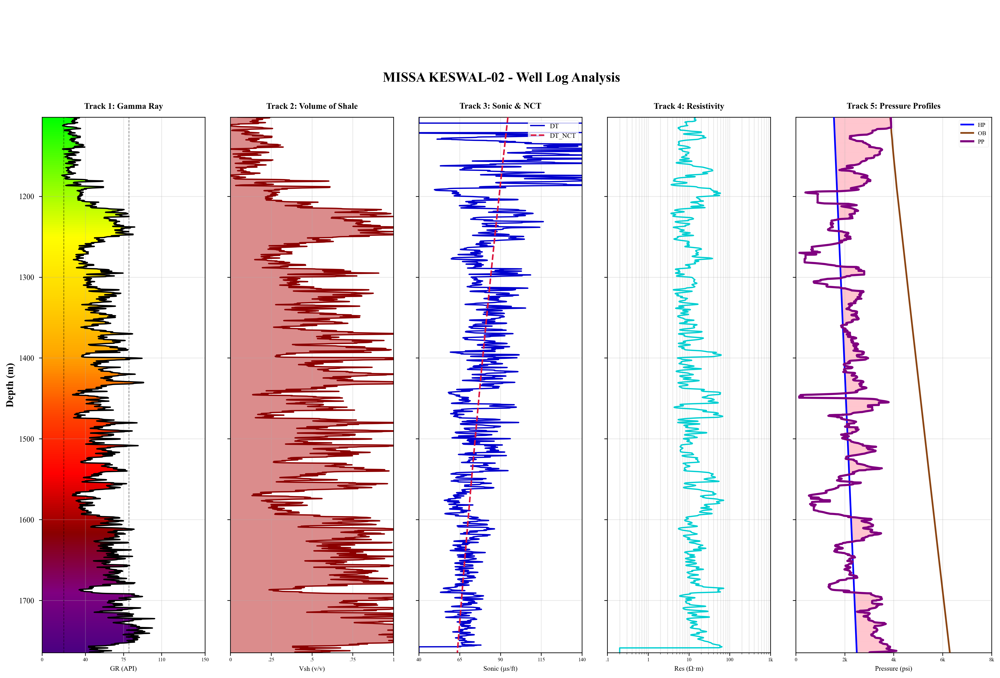


Well: MISSA KESWAL-02
Depth range: 1102.0 - 1764.8 m
Number of data points: 5294

Pressure statistics:
  Hydrostatic: 1555.4 - 2490.3 psi
  Pore Pressure: 136.4 - 4109.7 psi
  Overburden: 3854.4 - 6295.7 psi

Pressure zone analysis:
  Overpressure zones: 3621 (68.4%)
  Normal/Underpressure zones: 1673 (31.6%)

✅ MISSA KESWAL-02 well log has been generated with fixed x-axis labels!
   File saved as 'MISSA_KESWAL-02_well_log_fixed.png'


In [16]:
# ============================================
# MISSA KESWAL-02 Well Log Analysis - FIXED X-AXIS
# ============================================

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.patches import Polygon
from matplotlib.colors import LinearSegmentedColormap

# Load MISSA KESWAL-02 data
def load_missa_keswal_data(filepath):
    """Load and prepare MISSA KESWAL-02 well data"""
    df = pd.read_csv(filepath)
    df.columns = df.columns.str.strip().str.lower()
    df.replace(-999.25, np.nan, inplace=True)
    
    # Remove rows with NaN in critical columns
    df = df.dropna(subset=['depth', 'gr', 'dt', 'dt_nct', 'hp', 'ob', 'ppp'])
    
    return df

# Load the data (update filepath as needed)
filepath = 'C:\Geo\MISSA KESWAL-02.CSV'  # Update with your actual path
df_well = load_missa_keswal_data(filepath)

# Sort by depth
df_well_sorted = df_well.sort_values('depth').reset_index(drop=True)

# Calculate Volume of Shale (Vsh) from GR if not present
if 'vsh' not in df_well_sorted.columns:
    gr_clean = 20  
    gr_shale = 80  
    df_well_sorted['vsh'] = (df_well_sorted['gr'] - gr_clean) / (gr_shale - gr_clean)
    df_well_sorted['vsh'] = df_well_sorted['vsh'].clip(0, 1)

# Extract data for plotting
depth = df_well_sorted['depth'].values

# Create the figure
fig = plt.figure(figsize=(20, 12))
gs = GridSpec(2, 5, height_ratios=[0.05, 1], width_ratios=[1, 1, 1, 1, 1.2], 
              wspace=0.15, hspace=0.3)

# Create custom colormap for GR
colors_gr = ['#00FF00', '#7FFF00', '#FFFF00', '#FFD700', '#FFA500', 
             '#FF4500', '#FF0000', '#8B0000', '#800080', '#4B0082']
n_bins = 256
gr_cmap = LinearSegmentedColormap.from_list('gr_lithology', colors_gr, N=n_bins)

# Clear all top row cells 
for i in range(5):
    ax_temp = fig.add_subplot(gs[0, i])
    ax_temp.axis('off')

# Set common depth range
depth_min, depth_max = depth.min(), depth.max()

# ============================================
# Track 1: Gamma Ray
# ============================================
ax1 = fig.add_subplot(gs[1, 0])
gr = df_well_sorted['gr'].values

# Create vertical gradient
n_depth_steps = 1000 
depth_array = np.linspace(depth_min, depth_max, n_depth_steps)
depth_normalized = (depth_array - depth_min) / (depth_max - depth_min)
gradient_2d = np.tile(depth_normalized.reshape(-1, 1), (1, 2))

gradient_image = ax1.imshow(gradient_2d, extent=[0, 150, depth_max, depth_min], 
                           aspect='auto', cmap=gr_cmap, alpha=1.0, zorder=1)

# Create polygon mask
vertices = []
for i in range(len(depth)):
    vertices.append((gr[i], depth[i]))
for i in range(len(depth)-1, -1, -1):
    vertices.append((0, depth[i]))

poly = Polygon(vertices, closed=True, facecolor='none', edgecolor='none')
ax1.add_patch(poly)
gradient_image.set_clip_path(poly)

ax1.plot(gr, depth, color='black', linewidth=1.5, zorder=3)

gr_clean = 20
gr_shale = 80

ax1.set_xlim(0, 150)
ax1.set_ylim(depth_max, depth_min)
ax1.set_xlabel('GR (API)', fontsize=8)
ax1.set_ylabel('Depth (m)', fontsize=12, fontweight='bold')
ax1.grid(True, alpha=0.3, zorder=2)
ax1.set_title('Track 1: Gamma Ray', fontsize=10, fontweight='bold', pad=10)
ax1.axvline(x=gr_clean, color='black', linestyle='--', alpha=0.5, linewidth=0.8, zorder=2)
ax1.axvline(x=gr_shale, color='black', linestyle='--', alpha=0.5, linewidth=0.8, zorder=2)
ax1.set_xticks([0, 40, 75, 110, 150])
ax1.tick_params(axis='x', rotation=0, labelsize=6, pad=2)

# ============================================
# Track 2: Volume of Shale
# ============================================
ax2 = fig.add_subplot(gs[1, 1])
vsh = df_well_sorted['vsh'].values

ax2.plot(vsh, depth, color='#8B0000', linewidth=1.5)
ax2.fill_betweenx(depth, 0, vsh, where=(vsh >= 0), interpolate=True, 
                  color='#CD5C5C', alpha=0.7)

ax2.set_xlim(0, 1)
ax2.set_ylim(depth_max, depth_min)
ax2.set_xlabel('Vsh (v/v)', fontsize=8)
ax2.grid(True, alpha=0.3)
ax2.set_title('Track 2: Volume of Shale', fontsize=10, fontweight='bold', pad=10)
ax2.set_yticklabels([])
ax2.set_xticks([0, 0.25, 0.5, 0.75, 1])
ax2.set_xticklabels(['0', '.25', '.5', '.75', '1'])
ax2.tick_params(axis='x', rotation=0, labelsize=6, pad=2)

# ============================================
# Track 3: Sonic & NCT
# ============================================
ax3 = fig.add_subplot(gs[1, 2])
dt = df_well_sorted['dt'].values
dt_nct = df_well_sorted['dt_nct'].values

ax3.plot(dt, depth, color='#0000CD', linewidth=1.5, label='DT', zorder=2)
ax3.plot(dt_nct, depth, color='#DC143C', linewidth=1.8, label='DT_NCT', 
         linestyle='--', zorder=3)

ax3.set_xlim(40, 140)
ax3.set_ylim(depth_max, depth_min)
ax3.set_xlabel('Sonic (μs/ft)', fontsize=8)
ax3.grid(True, alpha=0.3)
ax3.set_title('Track 3: Sonic & NCT', fontsize=10, fontweight='bold', pad=10)
ax3.legend(loc='upper right', fontsize=8)
ax3.set_yticklabels([])
ax3.set_xticks([40, 65, 90, 115, 140])
ax3.tick_params(axis='x', rotation=0, labelsize=6, pad=2)

# ============================================
# Track 4: Resistivity
# ============================================
ax4 = fig.add_subplot(gs[1, 3])
if 'res_deep' in df_well_sorted.columns:
    res = df_well_sorted['res_deep'].values
    ax4.semilogx(res, depth, color='#00CED1', linewidth=1.5)
    ax4.set_xlim(0.1, 1000)
    ax4.set_xticks([0.1, 1, 10, 100, 1000])
    ax4.set_xticklabels(['.1', '1', '10', '100', '1k'])
    ax4.tick_params(axis='x', rotation=0, labelsize=6, pad=2)
else:
    ax4.text(0.5, (depth_min + depth_max) / 2, 'Resistivity Data Not Available', 
             rotation=90, va='center', ha='center', fontsize=12, color='gray')

ax4.set_ylim(depth_max, depth_min)
ax4.set_xlabel('Res (Ω·m)', fontsize=8)
ax4.grid(True, alpha=0.3, which='both')
ax4.set_title('Track 4: Resistivity', fontsize=10, fontweight='bold', pad=10)
ax4.set_yticklabels([])

# ============================================
# Track 5: Pressure Profiles
# ============================================
ax5 = fig.add_subplot(gs[1, 4])

hp = df_well_sorted['hp'].values
ob = df_well_sorted['ob'].values
ppp = df_well_sorted['ppp'].values

# Fill overpressure zones
for i in range(len(depth)-1):
    if ppp[i] > hp[i]:
        ax5.fill_betweenx([depth[i], depth[i+1]], hp[i], ppp[i], 
                          color='#FFB6C1', alpha=0.3, zorder=1)

# Plot pressure curves
ax5.plot(hp, depth, color='#0000FF', linewidth=2, label='HP', zorder=3)
ax5.plot(ob, depth, color='#8B4513', linewidth=2, label='OB', zorder=3)
ax5.plot(ppp, depth, color='#800080', linewidth=2.5, label='PP', zorder=4)

# Check if DST data exists
if 'dst' in df_well_sorted.columns:
    dst_data = df_well_sorted['dst'].dropna()
    if len(dst_data) > 0:
        dst_depths = df_well_sorted.loc[dst_data.index, 'depth'].values
        dst_values = dst_data.values
        ax5.scatter(dst_values, dst_depths, color='#FF1493', s=100, marker='D', 
                   label='DST', zorder=5, edgecolors='black', linewidth=1.5)

ax5.set_xlim(0, 8000)
ax5.set_ylim(depth_max, depth_min)
ax5.set_xlabel('Pressure (psi)', fontsize=8)
ax5.grid(True, alpha=0.3, zorder=0)
ax5.set_title('Track 5: Pressure Profiles', fontsize=10, fontweight='bold', pad=10)
ax5.legend(loc='upper right', fontsize=7)
ax5.set_yticklabels([])
ax5.set_xticks([0, 2000, 4000, 6000, 8000])
ax5.set_xticklabels(['0', '2k', '4k', '6k', '8k'])
ax5.tick_params(axis='x', rotation=0, labelsize=6, pad=2)

# ============================================
# Final touches
# ============================================
fig.suptitle('MISSA KESWAL-02 - Well Log Analysis', fontsize=16, fontweight='bold', y=0.90)
plt.tight_layout()
plt.subplots_adjust(top=0.99, hspace=0.001)
plt.savefig('MISSA_KESWAL-02_well_log_fixed.png', dpi=300, bbox_inches='tight')
plt.show()

# ============================================
# Print Statistics
# ============================================
print(f"\n{'='*60}")
print(f"Well: MISSA KESWAL-02")
print(f"Depth range: {depth_min:.1f} - {depth_max:.1f} m")
print(f"Number of data points: {len(depth)}")
print(f"\nPressure statistics:")
print(f"  Hydrostatic: {hp.min():.1f} - {hp.max():.1f} psi")
print(f"  Pore Pressure: {ppp.min():.1f} - {ppp.max():.1f} psi")
print(f"  Overburden: {ob.min():.1f} - {ob.max():.1f} psi")

# Print DST statistics if available
if 'dst' in df_well_sorted.columns:
    dst_data = df_well_sorted['dst'].dropna()
    if len(dst_data) > 0:
        print(f"\nDST Data:")
        print(f"  Number of DST points: {len(dst_data)}")
        print(f"  DST values: {dst_data.values}")
        print(f"  DST depths: {df_well_sorted.loc[dst_data.index, 'depth'].values}")

# Calculate overpressure zones
overpressure_count = np.sum(ppp > hp)
normal_pressure_count = np.sum(ppp <= hp)

print(f"\nPressure zone analysis:")
print(f"  Overpressure zones: {overpressure_count} ({overpressure_count/len(depth)*100:.1f}%)")
print(f"  Normal/Underpressure zones: {normal_pressure_count} ({normal_pressure_count/len(depth)*100:.1f}%)")

print("\n✅ MISSA KESWAL-02 well log has been generated with fixed x-axis labels!")
print("   File saved as 'MISSA_KESWAL-02_well_log_fixed.png'")

In [17]:
# ============================================
# CELL 1: DATA INJECTION EXPERIMENTS WITH EXISTING MODELS
# ============================================

import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import clone_model
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb

# Dictionary to store results
injection_results = {}

# Define injection percentages
injection_percentages = [0.10, 0.25]  # 10% and 25%

print("="*80)
print("DATA INJECTION EXPERIMENTS USING EXISTING MODELS")
print("="*80)
print("Using pre-trained models from original training on QAZIAN-1X and MISSA KESWAL wells")

for injection_pct in injection_percentages:
    print(f"\n{'='*60}")
    print(f"INJECTION: {int(injection_pct*100)}% of Blind Well Data (MISSA KESWAL-02)")
    print(f"{'='*60}")
    
    # Calculate the split for fine-tuning vs validation
    validation_pct = 1 - injection_pct
    
    # Split blind well data (using aligned version as in original code)
    df_finetune_temp, df_val_temp = train_test_split(
        blind_df_aligned, 
        test_size=validation_pct, 
        random_state=42
    )
    
    print(f"Fine-tuning samples: {len(df_finetune_temp)} ({injection_pct*100:.0f}%)")
    print(f"Validation samples: {len(df_val_temp)} ({validation_pct*100:.0f}%)")
    
    # Prepare data for fine-tuning
    X_ft_temp = df_finetune_temp[features].values
    y_ft_temp = df_finetune_temp[target_col].values
    X_val_temp = df_val_temp[features].values
    y_val_temp = df_val_temp[target_col].values
    
    # Scale features using the same scaler from original training
    X_ft_temp_s = scaler.transform(X_ft_temp)
    X_val_temp_s = scaler.transform(X_val_temp)
    
    # Reshape for CNN and RNN
    X_ft_temp_cnn = X_ft_temp_s.reshape(-1, len(features), 1)
    X_val_temp_cnn = X_val_temp_s.reshape(-1, len(features), 1)
    X_ft_temp_rnn = X_ft_temp_s.reshape(-1, len(features), 1)
    X_val_temp_rnn = X_val_temp_s.reshape(-1, len(features), 1)
    
    # Store results for this injection percentage
    injection_results[injection_pct] = {
        'df_val': df_val_temp,
        'df_finetune': df_finetune_temp,
        'X_val_s': X_val_temp_s,
        'X_val_cnn': X_val_temp_cnn,
        'X_val_rnn': X_val_temp_rnn,
        'y_val': y_val_temp,
        'models': {},
        'predictions': {},
        'metrics': {}
    }
    
    # Callbacks (same as original)
    es_temp = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    rlr_temp = ReduceLROnPlateau(monitor='val_loss', patience=5, factor=0.5, min_lr=1e-6)
    
    # ========== Fine-tune CNN ==========
    print(f"\n--- Fine-tuning CNN with {injection_pct*100:.0f}% data ---")
    cnn_temp = clone_model(cnn)
    cnn_temp.set_weights(cnn.get_weights())  # Start from original trained weights
    cnn_temp.compile(optimizer='adam', loss='mse')
    
    cnn_temp.fit(X_ft_temp_cnn, y_ft_temp,
                 validation_data=(X_val_temp_cnn, y_val_temp),
                 epochs=100, batch_size=16,
                 callbacks=[es_temp, rlr_temp], verbose=0)
    
    y_pred_cnn_temp = cnn_temp.predict(X_val_temp_cnn, verbose=0).flatten()
    injection_results[injection_pct]['models']['CNN'] = cnn_temp
    injection_results[injection_pct]['predictions']['CNN'] = y_pred_cnn_temp
    
    # ========== Fine-tune DFNN ==========
    print(f"--- Fine-tuning DFNN with {injection_pct*100:.0f}% data ---")
    dfnn_temp = clone_model(dfnn)
    dfnn_temp.set_weights(dfnn.get_weights())
    dfnn_temp.compile(optimizer='adam', loss='mse')
    
    dfnn_temp.fit(X_ft_temp_s, y_ft_temp,
                  validation_data=(X_val_temp_s, y_val_temp),
                  epochs=100, batch_size=16,
                  callbacks=[es_temp, rlr_temp], verbose=0)
    
    y_pred_dfnn_temp = dfnn_temp.predict(X_val_temp_s, verbose=0).flatten()
    injection_results[injection_pct]['models']['DFNN'] = dfnn_temp
    injection_results[injection_pct]['predictions']['DFNN'] = y_pred_dfnn_temp
    
    # ========== Fine-tune RNN ==========
    print(f"--- Fine-tuning RNN with {injection_pct*100:.0f}% data ---")
    rnn_temp = clone_model(rnn)
    rnn_temp.set_weights(rnn.get_weights())
    rnn_temp.compile(optimizer='adam', loss='mse')
    
    rnn_temp.fit(X_ft_temp_rnn, y_ft_temp,
                 validation_data=(X_val_temp_rnn, y_val_temp),
                 epochs=150, batch_size=16,
                 callbacks=[es_temp, rlr_temp], verbose=0)
    
    y_pred_rnn_temp = rnn_temp.predict(X_val_temp_rnn, verbose=0).flatten()
    injection_results[injection_pct]['models']['RNN'] = rnn_temp
    injection_results[injection_pct]['predictions']['RNN'] = y_pred_rnn_temp
    
    # ========== Fine-tune Random Forest ==========
    print(f"--- Fine-tuning Random Forest with {injection_pct*100:.0f}% data ---")
    rf_temp = RandomForestRegressor(
        n_estimators=500, max_depth=15,
        min_samples_split=5, min_samples_leaf=2,
        random_state=42, n_jobs=-1
    )
    rf_temp.fit(X_ft_temp_s, y_ft_temp)
    
    y_pred_rf_temp = rf_temp.predict(X_val_temp_s)
    injection_results[injection_pct]['models']['RF'] = rf_temp
    injection_results[injection_pct]['predictions']['RF'] = y_pred_rf_temp
    
    # ========== Fine-tune XGBoost ==========
    print(f"--- Fine-tuning XGBoost with {injection_pct*100:.0f}% data ---")
    xgb_temp = xgb.XGBRegressor(
        n_estimators=1000, max_depth=6,
        learning_rate=0.01, subsample=0.8,
        colsample_bytree=0.8, random_state=42,
        early_stopping_rounds=10
    )
    xgb_temp.fit(X_ft_temp_s, y_ft_temp,
                 eval_set=[(X_val_temp_s, y_val_temp)],
                 verbose=False)
    
    y_pred_xgb_temp = xgb_temp.predict(X_val_temp_s)
    injection_results[injection_pct]['models']['XGBoost'] = xgb_temp
    injection_results[injection_pct]['predictions']['XGBoost'] = y_pred_xgb_temp
    
    # Calculate metrics for all models
    print(f"\n📊 Results for {injection_pct*100:.0f}% data injection:")
    for model_name in ['CNN', 'DFNN', 'RNN', 'RF', 'XGBoost']:
        pred_key = 'RF' if model_name == 'RF' else model_name
        y_pred = injection_results[injection_pct]['predictions'][pred_key]
        
        r2 = r2_score(y_val_temp, y_pred)
        rmse = np.sqrt(mean_squared_error(y_val_temp, y_pred))
        mae = mean_absolute_error(y_val_temp, y_pred)
        rel = rmse/(y_val_temp.max()-y_val_temp.min())*100
        
        injection_results[injection_pct]['metrics'][model_name] = {
            'r2': r2, 'rmse': rmse, 'mae': mae, 'rel_rmse': rel
        }
        
        print(f"  {model_name:12} - R²={r2:.4f}, RMSE={rmse:.2f}, MAE={mae:.2f}, RelRMSE={rel:.2f}%")

# ========== COMPARISON TABLE ==========
print("\n" + "="*80)
print("PERFORMANCE COMPARISON ACROSS DATA INJECTION LEVELS")
print("="*80)
print(f"{'Model':<12} {'10% Injection':<20} {'25% Injection':<20} {'Improvement':<15}")
print(f"{'':12} {'R² / RMSE':<20} {'R² / RMSE':<20} {'ΔR² / ΔRMSE':<15}")
print("-"*80)

for model_name in ['CNN', 'DFNN', 'RNN', 'RF', 'XGBoost']:
    metrics_10 = injection_results[0.10]['metrics'][model_name]
    metrics_25 = injection_results[0.25]['metrics'][model_name]
    
    r2_improvement = metrics_25['r2'] - metrics_10['r2']
    rmse_improvement = metrics_10['rmse'] - metrics_25['rmse']  # Positive means improvement
    
    print(f"{model_name:<12} "
          f"{metrics_10['r2']:.3f} / {metrics_10['rmse']:<8.1f} "
          f"{metrics_25['r2']:.3f} / {metrics_25['rmse']:<8.1f} "
          f"{r2_improvement:+.3f} / {rmse_improvement:+.1f}")

print("\n✅ Data injection experiments completed successfully!")

DATA INJECTION EXPERIMENTS USING EXISTING MODELS
Using pre-trained models from original training on QAZIAN-1X and MISSA KESWAL wells

INJECTION: 10% of Blind Well Data (MISSA KESWAL-02)
Fine-tuning samples: 519 (10%)
Validation samples: 4671 (90%)

--- Fine-tuning CNN with 10% data ---
--- Fine-tuning DFNN with 10% data ---
--- Fine-tuning RNN with 10% data ---
--- Fine-tuning Random Forest with 10% data ---
--- Fine-tuning XGBoost with 10% data ---

📊 Results for 10% data injection:
  CNN          - R²=0.6764, RMSE=446.12, MAE=326.00, RelRMSE=11.23%
  DFNN         - R²=0.6343, RMSE=474.28, MAE=349.77, RelRMSE=11.94%
  RNN          - R²=0.6499, RMSE=464.06, MAE=344.38, RelRMSE=11.68%
  RF           - R²=0.8148, RMSE=337.52, MAE=219.42, RelRMSE=8.49%
  XGBoost      - R²=0.8818, RMSE=269.62, MAE=175.39, RelRMSE=6.79%

INJECTION: 25% of Blind Well Data (MISSA KESWAL-02)
Fine-tuning samples: 1297 (25%)
Validation samples: 3893 (75%)

--- Fine-tuning CNN with 25% data ---
--- Fine-tuning DF


GENERATING 5-TRACK WELL LOG VISUALIZATIONS

Creating well log for CNN with 10% injection...
  ✅ Saved: MISSA_KESWAL-02_CNN_10pct_injection.png


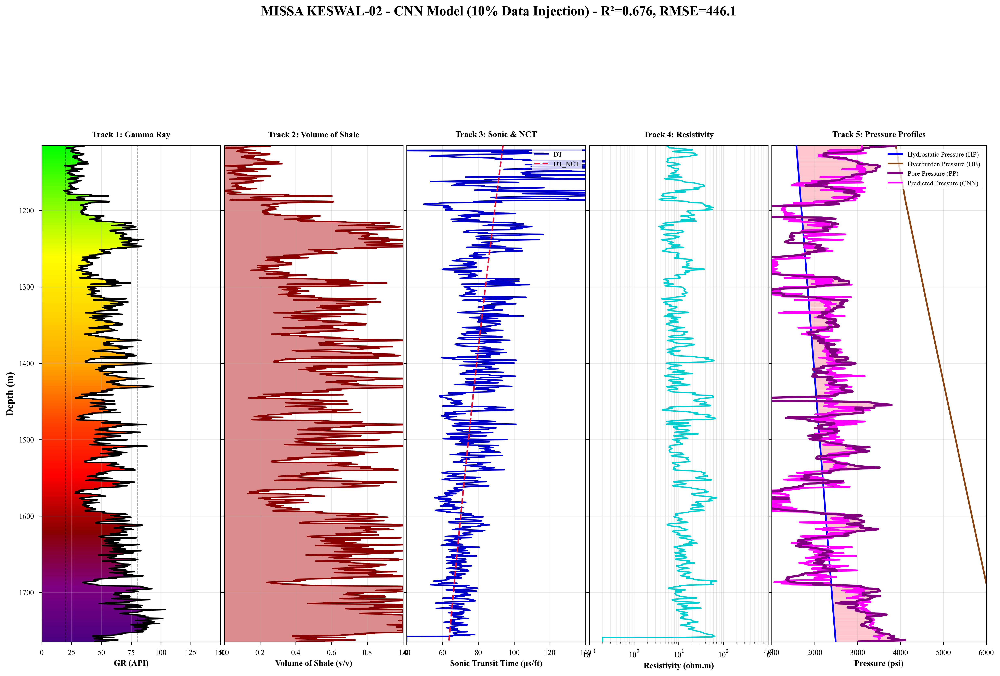


Creating well log for DFNN with 10% injection...
  ✅ Saved: MISSA_KESWAL-02_DFNN_10pct_injection.png


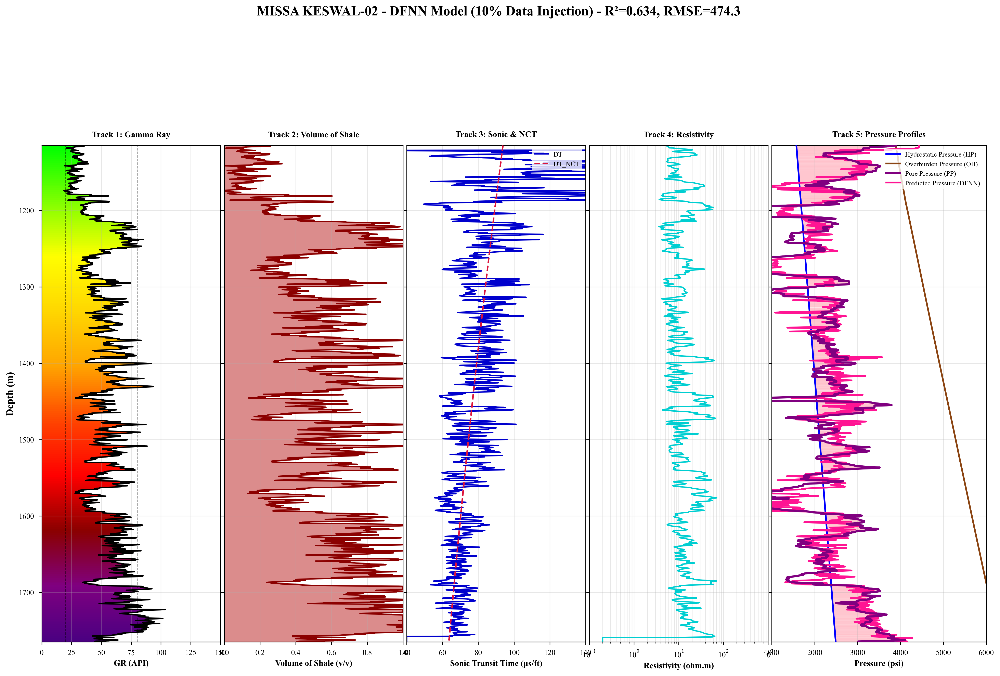


Creating well log for CNN with 25% injection...
  ✅ Saved: MISSA_KESWAL-02_CNN_25pct_injection.png


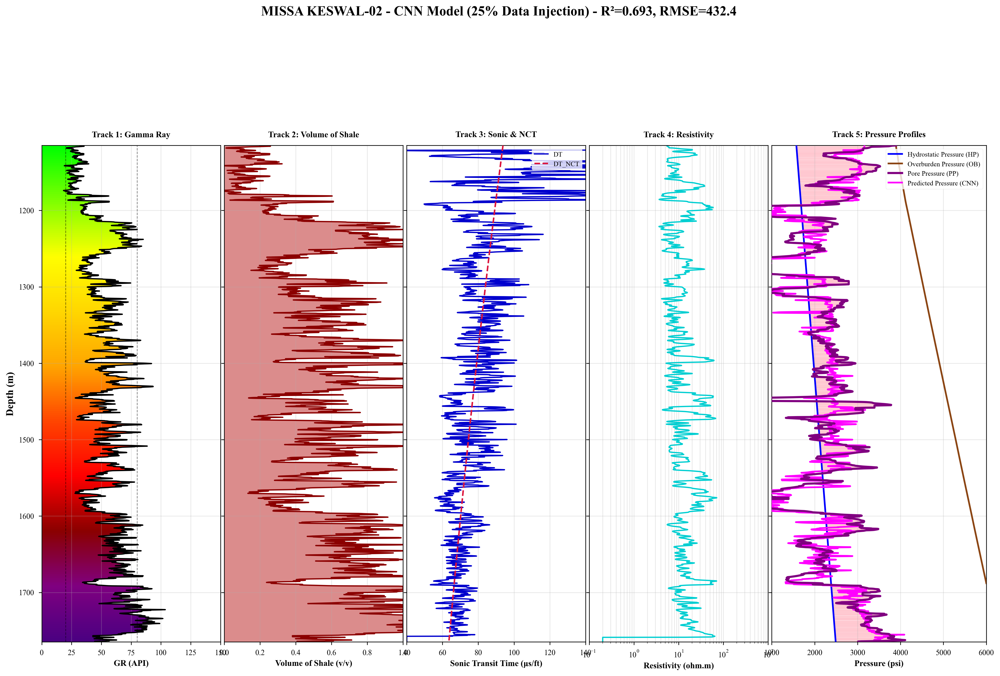


Creating well log for DFNN with 25% injection...
  ✅ Saved: MISSA_KESWAL-02_DFNN_25pct_injection.png


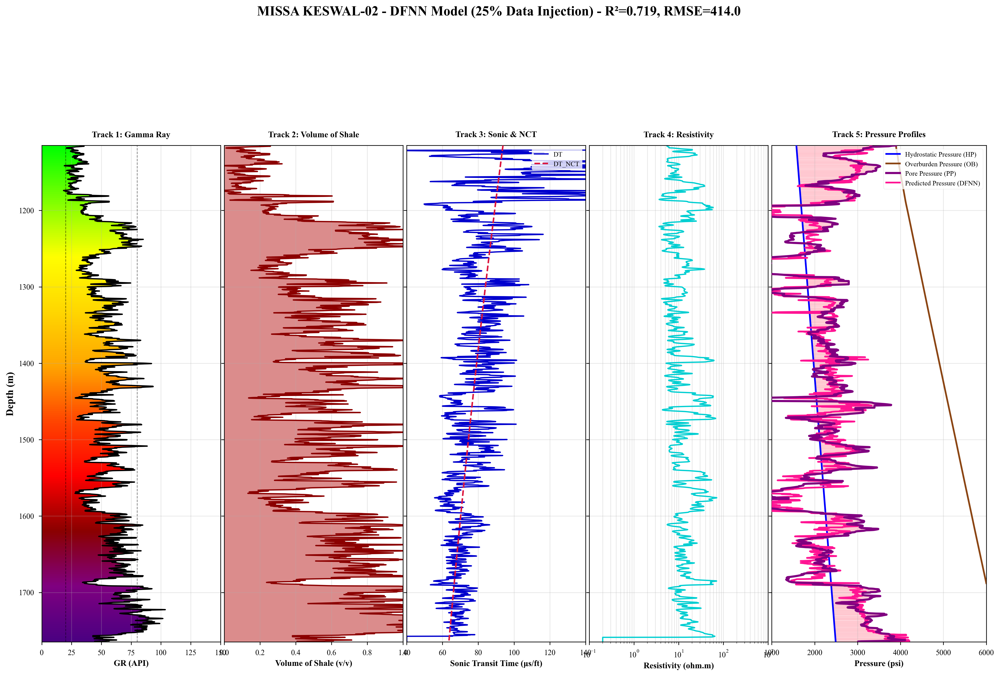


CREATING COMBINED COMPARISON FIGURE


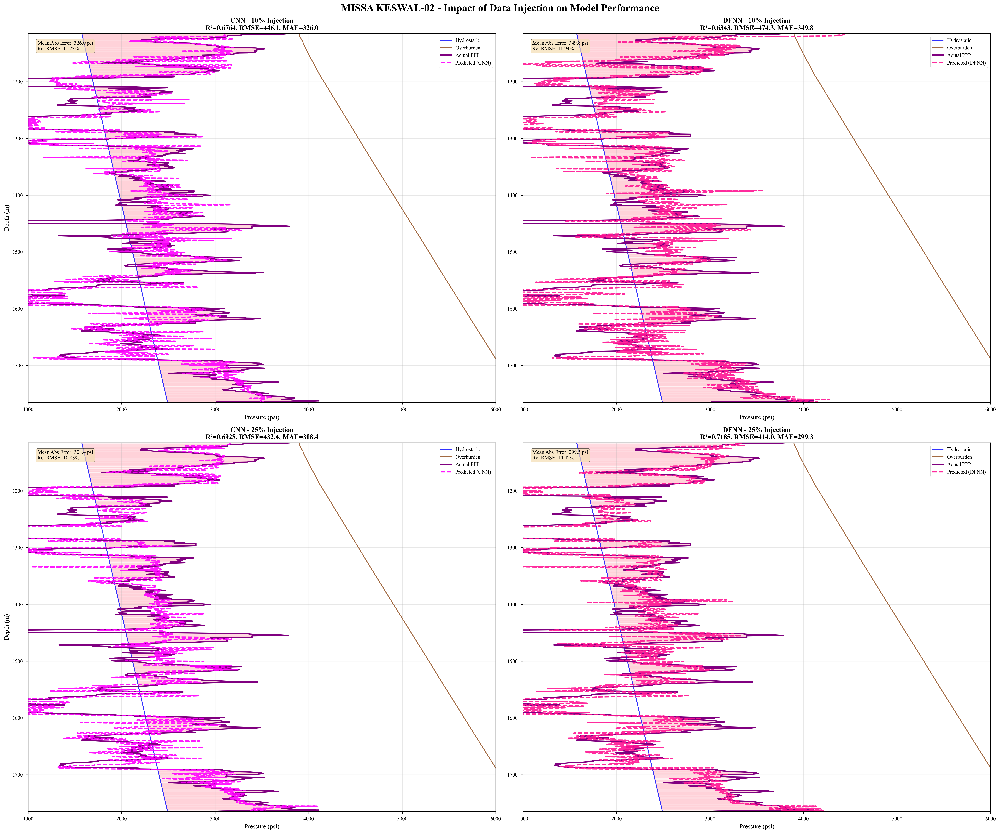


✅ All well log visualizations completed!

FINAL SUMMARY - BLIND WELL PERFORMANCE

Well: MISSA KESWAL-02
Total samples: 5190

Model Performance with Different Data Injection Levels:
------------------------------------------------------------

CNN Model:
  10% injection (519 train, 4671 val): R²=0.6764, RMSE=446.1 psi
  25% injection (1297 train, 3893 val): R²=0.6928, RMSE=432.4 psi

DFNN Model:
  10% injection (519 train, 4671 val): R²=0.6343, RMSE=474.3 psi
  25% injection (1297 train, 3893 val): R²=0.7185, RMSE=414.0 psi

Analysis Complete!


In [18]:
# ============================================
# 5-TRACK WELL LOG VISUALIZATIONS FOR CNN AND DFNN
# ============================================

import matplotlib.pyplot as plt
import numpy as np
from matplotlib.gridspec import GridSpec
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.patches import Polygon
import seaborn as sns

# Set style
plt.style.use('seaborn-v0_8-paper')
plt.rcParams.update({
    'figure.dpi': 300,
    'savefig.dpi': 300,
    'font.size': 10,
    'axes.labelsize': 10,
    'axes.titlesize': 12,
    'xtick.labelsize': 9,
    'ytick.labelsize': 9,
    'legend.fontsize': 9,
    'figure.figsize': (8, 6),
    'font.family': 'serif',
    'font.serif': ['Times New Roman']
})

def create_5track_well_log(injection_pct, model_name):
    """
    Create 5-track well log visualization exactly as in the original code
    """
    # Get validation data and predictions
    val_indices = injection_results[injection_pct]['df_val'].index
    
    # Create a dataframe with original values from blind_df
    df_well = blind_df.loc[val_indices].copy()
    
    # Get predictions for the specified model
    if model_name == 'CNN':
        df_well['predicted_pressure'] = injection_results[injection_pct]['predictions']['CNN']
    elif model_name == 'DFNN':
        df_well['predicted_pressure'] = injection_results[injection_pct]['predictions']['DFNN']
    
    # Set well name
    well_name = "MISSA KESWAL-02"
    
    # Sort by depth
    df_well_sorted = df_well.sort_values('depth').reset_index(drop=True)
    
    # Calculate Volume of Shale (Vsh) from GR if not present
    if 'vsh' not in df_well_sorted.columns:
        gr_clean = 20  
        gr_shale = 80  
        df_well_sorted['vsh'] = (df_well_sorted['gr'] - gr_clean) / (gr_shale - gr_clean)
        df_well_sorted['vsh'] = df_well_sorted['vsh'].clip(0, 1)
    
    # Extract data for plotting
    depth = df_well_sorted['depth'].values
    
    # Create the figure 
    fig = plt.figure(figsize=(20, 12))
    gs = GridSpec(2, 5, height_ratios=[0.05, 1], width_ratios=[1, 1, 1, 1, 1.2], 
                  wspace=0.02, hspace=0.3)
    
    # Create custom colormap for GR
    colors_gr = ['#00FF00', '#7FFF00', '#FFFF00', '#FFD700', '#FFA500', 
                 '#FF4500', '#FF0000', '#8B0000', '#800080', '#4B0082']
    n_bins = 256
    gr_cmap = LinearSegmentedColormap.from_list('gr_lithology', colors_gr, N=n_bins)
    
    # Clear all top row cells 
    for i in range(5):
        ax_temp = fig.add_subplot(gs[0, i])
        ax_temp.axis('off')
    
    # Set common depth range
    depth_min, depth_max = depth.min(), depth.max()
    
    # ========== Track 1: Gamma Ray ==========
    ax1 = fig.add_subplot(gs[1, 0])
    gr = df_well_sorted['gr'].values
    
    # Create vertical gradient
    n_depth_steps = 1000 
    depth_array = np.linspace(depth_min, depth_max, n_depth_steps)
    depth_normalized = (depth_array - depth_min) / (depth_max - depth_min)
    gradient_2d = np.tile(depth_normalized.reshape(-1, 1), (1, 2))
    
    gradient_image = ax1.imshow(gradient_2d, extent=[0, 150, depth_max, depth_min], 
                               aspect='auto', cmap=gr_cmap, alpha=1.0, zorder=1)
    
    # Create polygon mask
    vertices = []
    for i in range(len(depth)):
        vertices.append((gr[i], depth[i]))
    for i in range(len(depth)-1, -1, -1):
        vertices.append((0, depth[i]))
    
    poly = Polygon(vertices, closed=True, facecolor='none', edgecolor='none')
    ax1.add_patch(poly)
    gradient_image.set_clip_path(poly)
    
    ax1.plot(gr, depth, color='black', linewidth=1.5, zorder=3)
    
    gr_clean = 20
    gr_shale = 80
    
    ax1.set_xlim(0, 150)
    ax1.set_ylim(depth_max, depth_min)
    ax1.set_xlabel('GR (API)', fontsize=10, fontweight='bold')
    ax1.set_ylabel('Depth (m)', fontsize=12, fontweight='bold')
    ax1.grid(True, alpha=0.3, zorder=2)
    ax1.set_title('Track 1: Gamma Ray', fontsize=10, fontweight='bold', pad=10)
    ax1.axvline(x=gr_clean, color='black', linestyle='--', alpha=0.5, linewidth=0.8, zorder=2)
    ax1.axvline(x=gr_shale, color='black', linestyle='--', alpha=0.5, linewidth=0.8, zorder=2)
    
    # ========== Track 2: Volume of Shale ==========
    ax2 = fig.add_subplot(gs[1, 1])
    vsh = df_well_sorted['vsh'].values
    
    ax2.plot(vsh, depth, color='#8B0000', linewidth=1.5)
    ax2.fill_betweenx(depth, 0, vsh, where=(vsh >= 0), interpolate=True, 
                      color='#CD5C5C', alpha=0.7)
    
    ax2.set_xlim(0, 1)
    ax2.set_ylim(depth_max, depth_min)
    ax2.set_xlabel('Volume of Shale (v/v)', fontsize=10, fontweight='bold')
    ax2.grid(True, alpha=0.3)
    ax2.set_title('Track 2: Volume of Shale', fontsize=10, fontweight='bold', pad=10)
    ax2.set_yticklabels([])
    
    # ========== Track 3: Sonic & NCT ==========
    ax3 = fig.add_subplot(gs[1, 2])
    dt = df_well_sorted['dt'].values
    dt_nct = df_well_sorted['dt_nct'].values
    
    ax3.plot(dt, depth, color='#0000CD', linewidth=1.5, label='DT', zorder=2)
    ax3.plot(dt_nct, depth, color='#DC143C', linewidth=1.8, label='DT_NCT', 
             linestyle='--', zorder=3)
    
    ax3.set_xlim(40, 140)
    ax3.set_ylim(depth_max, depth_min)
    ax3.set_xlabel('Sonic Transit Time (μs/ft)', fontsize=10, fontweight='bold')
    ax3.grid(True, alpha=0.3)
    ax3.set_title('Track 3: Sonic & NCT', fontsize=10, fontweight='bold', pad=10)
    ax3.legend(loc='upper right', fontsize=8)
    ax3.set_yticklabels([])
    
    # ========== Track 4: Resistivity ==========
    ax4 = fig.add_subplot(gs[1, 3])
    if 'res_deep' in df_well_sorted.columns:
        res = df_well_sorted['res_deep'].values
        ax4.semilogx(res, depth, color='#00CED1', linewidth=1.5)
        ax4.set_xlim(0.1, 1000)
    else:
        ax4.text(0.5, (depth_min + depth_max) / 2, 'Resistivity Data Not Available', 
                 rotation=90, va='center', ha='center', fontsize=12, color='gray')
    
    ax4.set_ylim(depth_max, depth_min)
    ax4.set_xlabel('Resistivity (ohm.m)', fontsize=10, fontweight='bold')
    ax4.grid(True, alpha=0.3, which='both')
    ax4.set_title('Track 4: Resistivity', fontsize=10, fontweight='bold', pad=10)
    ax4.set_yticklabels([])
    
    # ========== Track 5: Pressure Profiles ==========
    ax5 = fig.add_subplot(gs[1, 4])
    
    hp = df_well_sorted['hp'].values
    ob = df_well_sorted['ob'].values
    ppp = df_well_sorted['ppp'].values
    predicted_pressure = df_well_sorted['predicted_pressure'].values
    
    # Fill overpressure zones
    for i in range(len(depth)-1):
        if ppp[i] > hp[i]:
            ax5.fill_betweenx([depth[i], depth[i+1]], hp[i], ppp[i], 
                              color='#FFB6C1', alpha=0.3, zorder=1)
    
    ax5.plot(hp, depth, color='#0000FF', linewidth=2, label='Hydrostatic Pressure (HP)', zorder=3)
    ax5.plot(ob, depth, color='#8B4513', linewidth=2, label='Overburden Pressure (OB)', zorder=3)
    ax5.plot(ppp, depth, color='#800080', linewidth=2.5, label='Pore Pressure (PP)', zorder=4)
    
    # Use different color for predicted based on model
    pred_color = '#FF00FF' if model_name == 'CNN' else '#FF1493'
    ax5.plot(predicted_pressure, depth, color=pred_color, linewidth=2, 
             label=f'Predicted Pressure ({model_name})', linestyle='-', zorder=3)
    
    ax5.set_xlim(1000, 6000)
    ax5.set_ylim(depth_max, depth_min)
    ax5.set_xlabel('Pressure (psi)', fontsize=10, fontweight='bold')
    ax5.grid(True, alpha=0.3, zorder=0)
    ax5.set_title('Track 5: Pressure Profiles', fontsize=10, fontweight='bold', pad=10)
    ax5.legend(loc='upper right', fontsize=8)
    ax5.set_yticklabels([])
    
    # Add title with injection percentage and metrics
    metrics = injection_results[injection_pct]['metrics'][model_name]
    fig.suptitle(f'{well_name} - {model_name} Model ({int(injection_pct*100)}% Data Injection) - R²={metrics["r2"]:.3f}, RMSE={metrics["rmse"]:.1f}', 
                fontsize=16, fontweight='bold', y=0.98)
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.93, hspace=0.3)
    
    return fig

# ============================================
# Generate individual well log plots
# ============================================

print("\n" + "="*80)
print("GENERATING 5-TRACK WELL LOG VISUALIZATIONS")
print("="*80)

# Generate plots for each combination
plot_configs = [
    (0.10, 'CNN'),
    (0.10, 'DFNN'),
    (0.25, 'CNN'),
    (0.25, 'DFNN')
]

for injection_pct, model_name in plot_configs:
    print(f"\nCreating well log for {model_name} with {int(injection_pct*100)}% injection...")
    
    # Create the figure
    fig = create_5track_well_log(injection_pct, model_name)
    
    # Save the figure
    filename = f'MISSA_KESWAL-02_{model_name}_{int(injection_pct*100)}pct_injection.png'
    fig.savefig(filename, dpi=300, bbox_inches='tight')
    print(f"  ✅ Saved: {filename}")
    plt.show()

# ============================================
# Create comparison figure showing all 4 scenarios
# ============================================

print("\n" + "="*80)
print("CREATING COMBINED COMPARISON FIGURE")
print("="*80)

fig = plt.figure(figsize=(24, 20))
fig.suptitle('MISSA KESWAL-02 - Impact of Data Injection on Model Performance', 
            fontsize=18, fontweight='bold', y=0.995)

# Create 4 subplots in 2x2 arrangement
for idx, (injection_pct, model_name) in enumerate(plot_configs):
    ax_idx = idx + 1
    ax = plt.subplot(2, 2, ax_idx)
    
    # Get data
    val_indices = injection_results[injection_pct]['df_val'].index
    df_plot = blind_df.loc[val_indices].copy()
    df_plot_sorted = df_plot.sort_values('depth').reset_index(drop=True)
    
    depth = df_plot_sorted['depth'].values
    hp = df_plot_sorted['hp'].values
    ob = df_plot_sorted['ob'].values
    ppp = df_plot_sorted['ppp'].values
    
    # Get predictions
    if model_name == 'CNN':
        predictions = injection_results[injection_pct]['predictions']['CNN']
    else:
        predictions = injection_results[injection_pct]['predictions']['DFNN']
    
    # Sort predictions to match depth order
    pred_sorted = predictions[np.argsort(df_plot['depth'].values)]
    
    # Fill overpressure zones
    for i in range(len(depth)-1):
        if ppp[i] > hp[i]:
            ax.fill_betweenx([depth[i], depth[i+1]], hp[i], ppp[i], 
                            color='#FFB6C1', alpha=0.2)
    
    # Plot pressure curves
    ax.plot(hp, depth, color='#0000FF', linewidth=1.5, label='Hydrostatic', alpha=0.8)
    ax.plot(ob, depth, color='#8B4513', linewidth=1.5, label='Overburden', alpha=0.8)
    ax.plot(ppp, depth, color='#800080', linewidth=2, label='Actual PPP')
    
    # Different colors for each model
    pred_color = '#FF00FF' if model_name == 'CNN' else '#FF1493'
    ax.plot(pred_sorted, depth, color=pred_color, linewidth=2, 
            label=f'Predicted ({model_name})', linestyle='--', alpha=0.9)
    
    # Calculate error
    error = np.abs(ppp - pred_sorted)
    mean_error = np.mean(error)
    
    # Styling
    ax.set_xlim(1000, 6000)
    ax.set_ylim(depth.max(), depth.min())
    ax.set_xlabel('Pressure (psi)', fontsize=11)
    ax.set_ylabel('Depth (m)' if idx in [0, 2] else '', fontsize=11)
    ax.grid(True, alpha=0.3)
    ax.legend(loc='upper right', fontsize=9)
    
    # Add metrics
    metrics = injection_results[injection_pct]['metrics'][model_name]
    title = f'{model_name} - {int(injection_pct*100)}% Injection\n'
    title += f'R²={metrics["r2"]:.4f}, RMSE={metrics["rmse"]:.1f}, MAE={metrics["mae"]:.1f}'
    ax.set_title(title, fontsize=12, fontweight='bold')
    
    # Add text box with additional stats
    textstr = f'Mean Abs Error: {mean_error:.1f} psi\n'
    textstr += f'Rel RMSE: {metrics["rel_rmse"]:.2f}%'
    ax.text(0.02, 0.98, textstr, transform=ax.transAxes, fontsize=9,
            verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.7))

plt.tight_layout()
plt.subplots_adjust(top=0.96)
plt.savefig('MISSA_KESWAL-02_injection_comparison_all.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n✅ All well log visualizations completed!")

# ============================================
# Print final summary statistics
# ============================================

print("\n" + "="*80)
print("FINAL SUMMARY - BLIND WELL PERFORMANCE")
print("="*80)
print(f"\nWell: MISSA KESWAL-02")
print(f"Total samples: {len(blind_df)}")
print(f"\nModel Performance with Different Data Injection Levels:")
print("-"*60)

for model_name in ['CNN', 'DFNN']:
    print(f"\n{model_name} Model:")
    for injection_pct in [0.10, 0.25]:
        metrics = injection_results[injection_pct]['metrics'][model_name]
        n_train = len(injection_results[injection_pct]['df_finetune'])
        n_val = len(injection_results[injection_pct]['df_val'])
        print(f"  {int(injection_pct*100):2d}% injection ({n_train:3d} train, {n_val:3d} val): "
              f"R²={metrics['r2']:.4f}, RMSE={metrics['rmse']:.1f} psi")

print("\n" + "="*80)
print("Analysis Complete!")
print("="*80)

Generating Actual vs Predicted Scatter Plots...


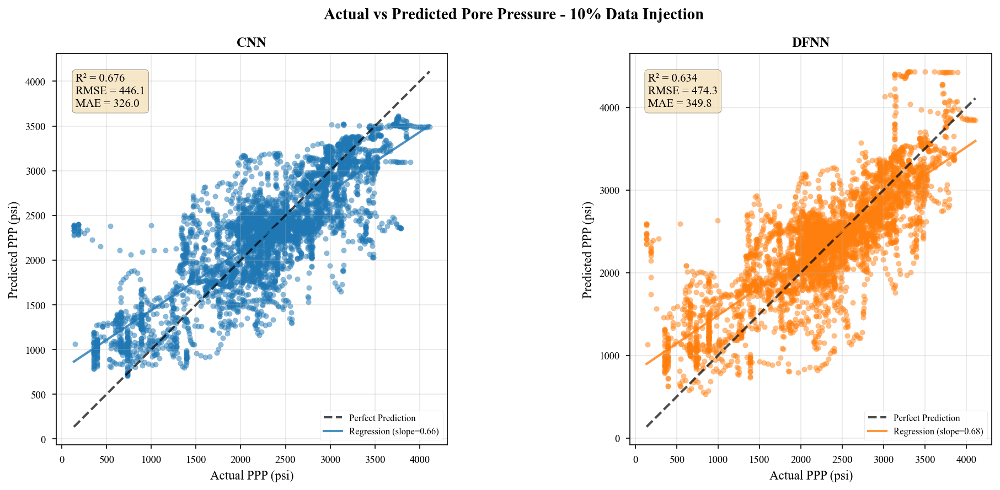

  ✅ Saved: scatter_plot_10pct_injection.png


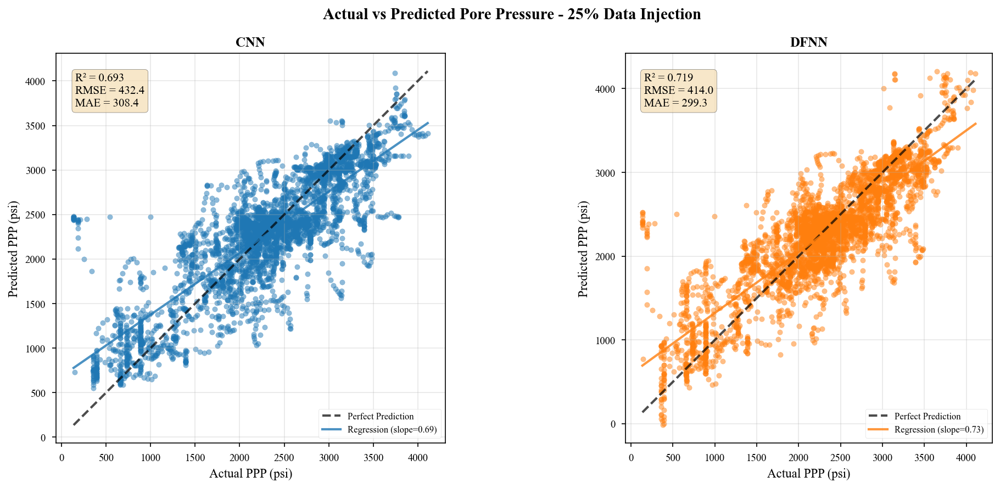

  ✅ Saved: scatter_plot_25pct_injection.png

Generating Residuals Analysis Plots...


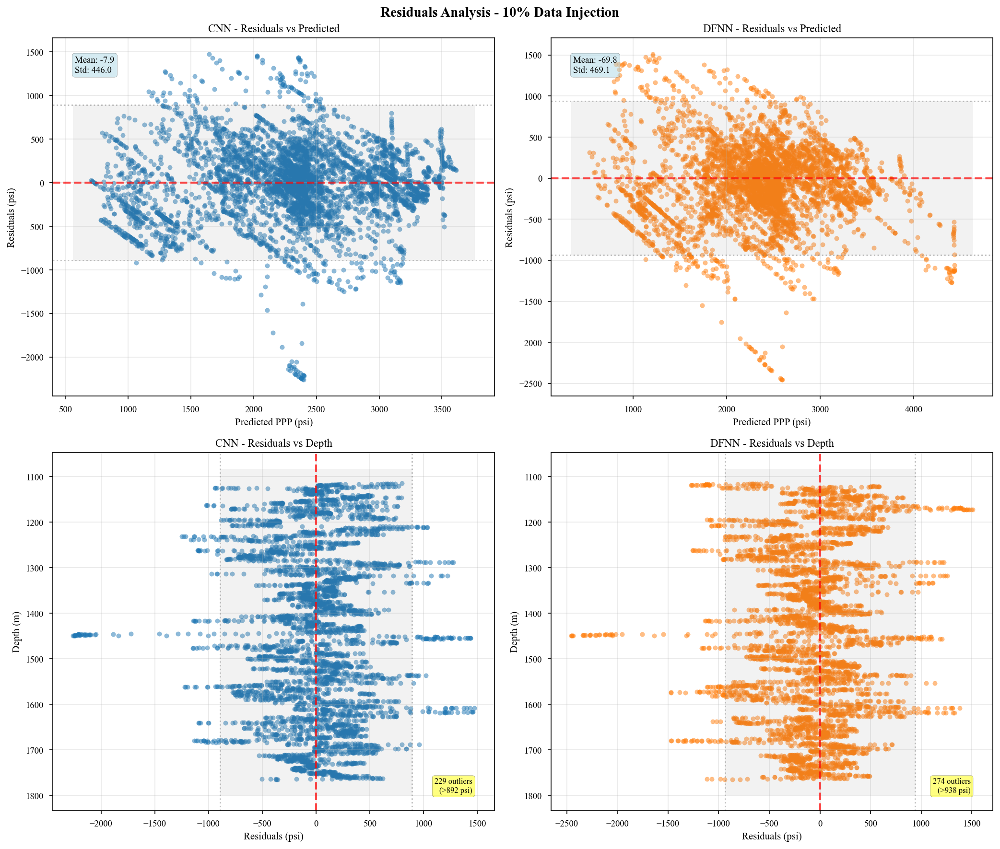

  ✅ Saved: residuals_analysis_10pct_injection.png


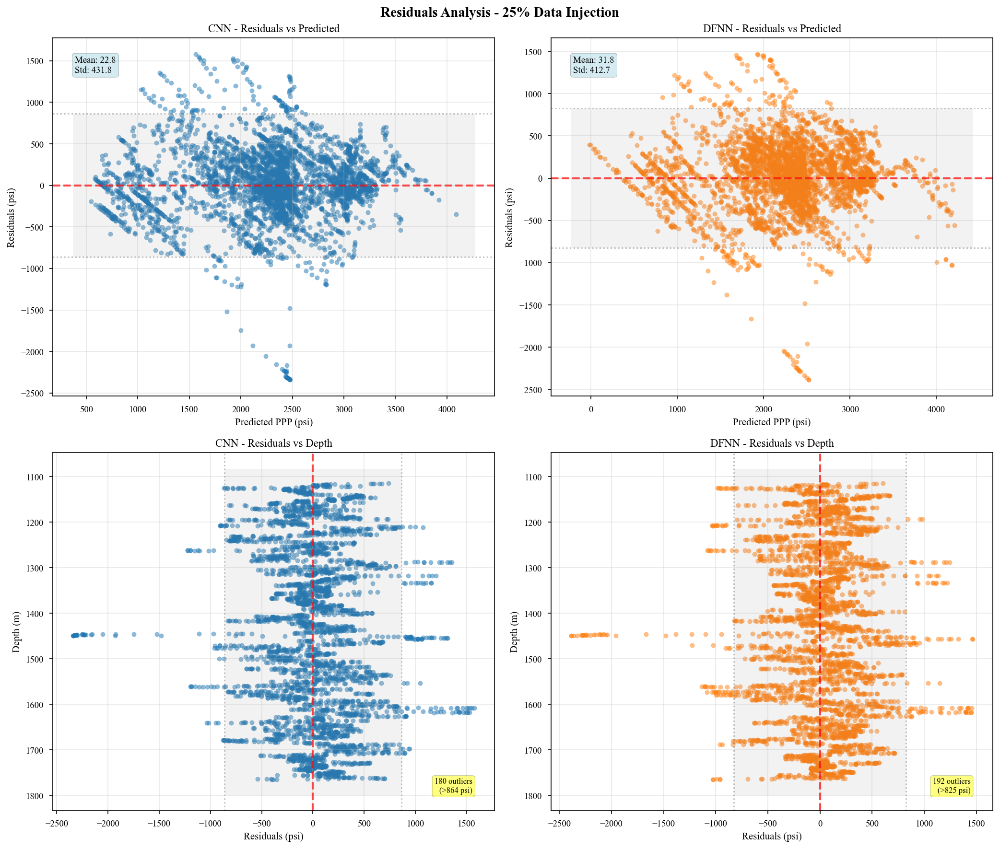

  ✅ Saved: residuals_analysis_25pct_injection.png

Generating Combined Comparison Plot...


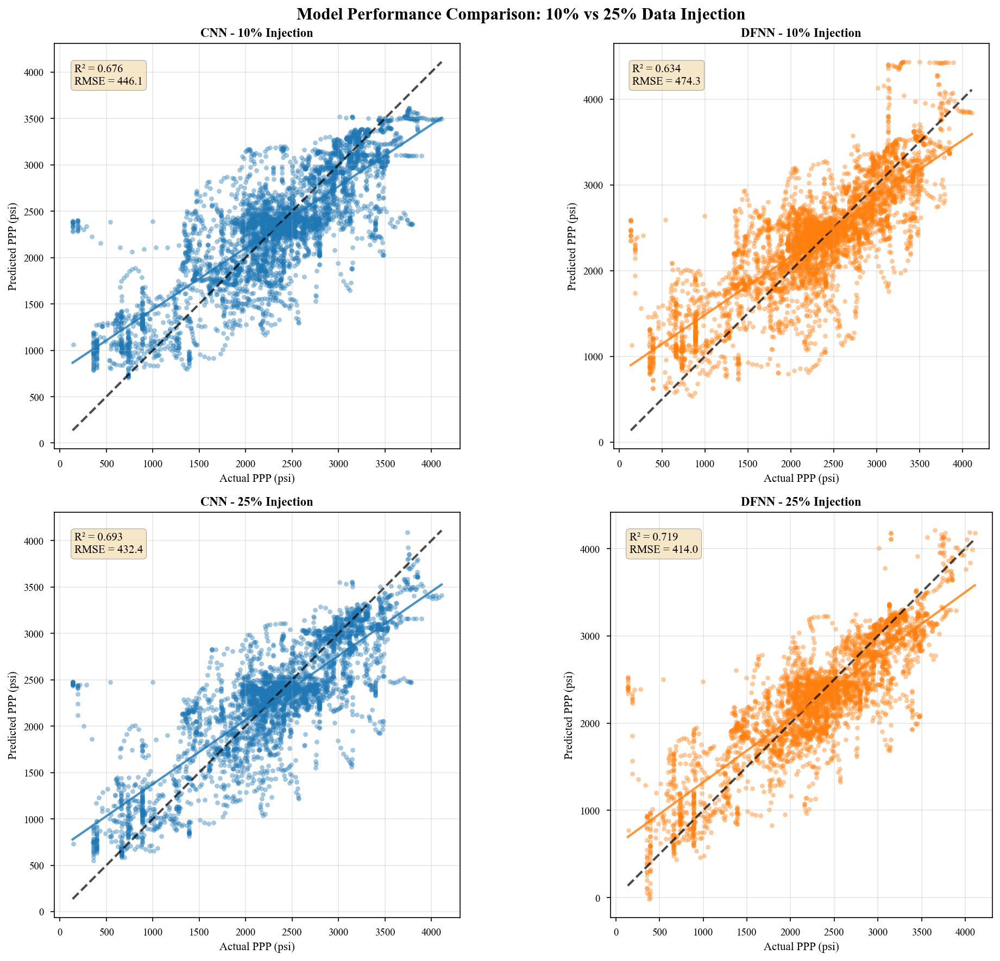

  ✅ Saved: comparison_all_scenarios.png

Generating Residuals Distribution Plots...


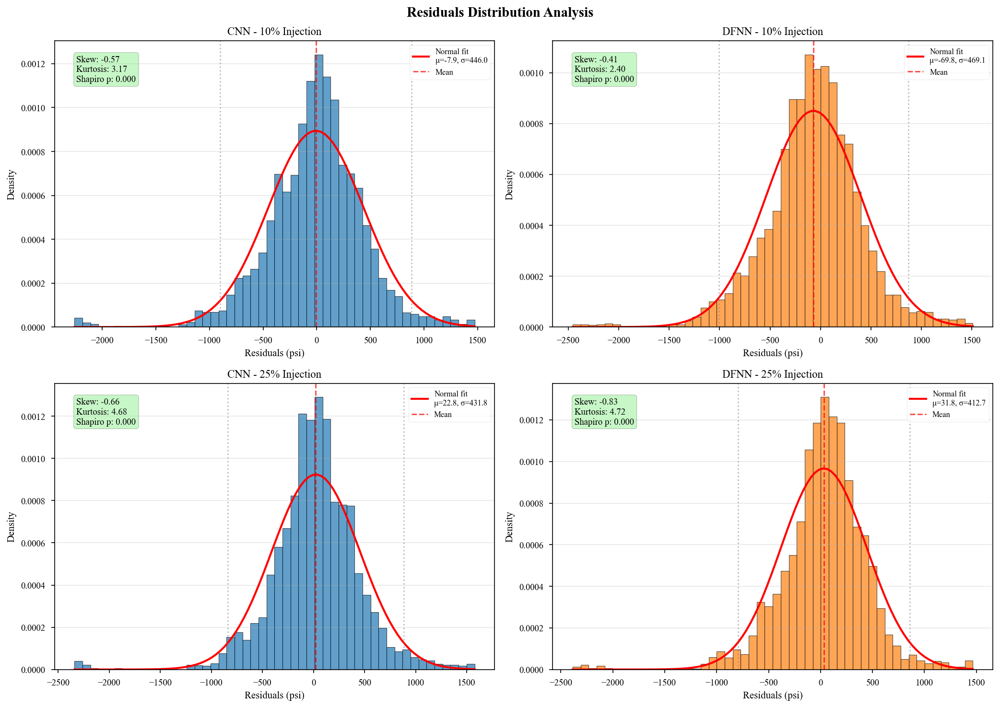

  ✅ Saved: residuals_distribution.png

RESIDUALS STATISTICAL SUMMARY
Model      Injection    Mean         Std Dev      Min          Max          Skewness  
----------------------------------------------------------------------------------------------
CNN        10%          -7.89        446.05       -2260.52     1472.22      -0.573    
DFNN       10%          -69.76       469.12       -2456.48     1508.81      -0.414    
CNN        25%          22.76        431.83       -2341.05     1577.87      -0.656    
DFNN       25%          31.75        412.73       -2386.61     1465.58      -0.828    

✨ All residuals analysis plots completed!


In [19]:
# ============================================
# CELL 3: ACTUAL VS PREDICTED SCATTER PLOTS WITH RESIDUALS ANALYSIS
# ============================================

import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from scipy import stats
import seaborn as sns

# Set style for publication-quality plots
plt.style.use('seaborn-v0_8-paper')
plt.rcParams.update({
    'figure.dpi': 150,
    'savefig.dpi': 300,
    'font.size': 10,
    'axes.labelsize': 11,
    'axes.titlesize': 12,
    'xtick.labelsize': 9,
    'ytick.labelsize': 9,
    'legend.fontsize': 9,
    'font.family': 'serif',
    'font.serif': ['Times New Roman']
})

# Define colors for models
colors_models = {
    'CNN': '#1f77b4',
    'DFNN': '#ff7f0e'
}

# ============================================
# Figure 1: Actual vs Predicted for Different Injection Levels
# ============================================

print("Generating Actual vs Predicted Scatter Plots...")

for injection_pct in [0.10, 0.25]:
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))
    fig.suptitle(f'Actual vs Predicted Pore Pressure - {int(injection_pct*100)}% Data Injection', 
                 fontsize=14, fontweight='bold')
    
    for idx, model_name in enumerate(['CNN', 'DFNN']):
        ax = axes[idx]
        
        # Get actual and predicted values
        y_actual = injection_results[injection_pct]['y_val']
        y_pred = injection_results[injection_pct]['predictions'][model_name]
        
        # Calculate metrics
        r2 = r2_score(y_actual, y_pred)
        rmse = np.sqrt(mean_squared_error(y_actual, y_pred))
        mae = mean_absolute_error(y_actual, y_pred)
        
        # Create scatter plot
        ax.scatter(y_actual, y_pred, alpha=0.5, s=20, 
                  color=colors_models[model_name], edgecolors=None)
        
        # Add perfect prediction line
        min_val, max_val = y_actual.min(), y_actual.max()
        ax.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2, alpha=0.7, 
                label='Perfect Prediction')
        
        # Add regression line
        z = np.polyfit(y_actual, y_pred, 1)
        p = np.poly1d(z)
        x_line = np.linspace(min_val, max_val, 100)
        ax.plot(x_line, p(x_line), "-", color=colors_models[model_name], 
                lw=2, alpha=0.8, label=f'Regression (slope={z[0]:.2f})')
        
        # Styling
        ax.set_xlabel('Actual PPP (psi)', fontsize=11)
        ax.set_ylabel('Predicted PPP (psi)', fontsize=11)
        ax.set_title(model_name, fontsize=12, fontweight='bold')
        ax.set_aspect('equal', adjustable='box')
        ax.grid(True, alpha=0.3)
        ax.legend(loc='lower right', fontsize=8)
        
        # Add metrics text box
        textstr = f'R² = {r2:.3f}\nRMSE = {rmse:.1f}\nMAE = {mae:.1f}'
        ax.text(0.05, 0.95, textstr, transform=ax.transAxes, fontsize=10,
                verticalalignment='top', 
                bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.7))
    
    plt.tight_layout()
    filename = f'scatter_plot_{int(injection_pct*100)}pct_injection.png'
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()
    print(f"  ✅ Saved: {filename}")

# ============================================
# Figure 2: Residuals Analysis
# ============================================

print("\nGenerating Residuals Analysis Plots...")

for injection_pct in [0.10, 0.25]:
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))
    fig.suptitle(f'Residuals Analysis - {int(injection_pct*100)}% Data Injection', 
                 fontsize=14, fontweight='bold')
    
    for col, model_name in enumerate(['CNN', 'DFNN']):
        # Get actual and predicted values
        y_actual = injection_results[injection_pct]['y_val']
        y_pred = injection_results[injection_pct]['predictions'][model_name]
        
        # Calculate residuals
        residuals = y_actual - y_pred
        
        # Get corresponding depth values
        val_indices = injection_results[injection_pct]['df_val'].index
        df_val = blind_df.loc[val_indices].copy()
        depth = df_val['depth'].values
        
        # --- Top row: Residuals vs Predicted ---
        ax1 = axes[0, col]
        ax1.scatter(y_pred, residuals, alpha=0.5, s=20, 
                   color=colors_models[model_name])
        ax1.axhline(y=0, color='red', linestyle='--', lw=2, alpha=0.7)
        
        # Add confidence bands (±2 std)
        std_residuals = np.std(residuals)
        ax1.axhline(y=2*std_residuals, color='gray', linestyle=':', alpha=0.5)
        ax1.axhline(y=-2*std_residuals, color='gray', linestyle=':', alpha=0.5)
        ax1.fill_between(ax1.get_xlim(), -2*std_residuals, 2*std_residuals, 
                         alpha=0.1, color='gray')
        
        ax1.set_xlabel('Predicted PPP (psi)', fontsize=10)
        ax1.set_ylabel('Residuals (psi)', fontsize=10)
        ax1.set_title(f'{model_name} - Residuals vs Predicted', fontsize=11)
        ax1.grid(True, alpha=0.3)
        
        # Add statistics
        textstr = f'Mean: {np.mean(residuals):.1f}\nStd: {std_residuals:.1f}'
        ax1.text(0.05, 0.95, textstr, transform=ax1.transAxes, fontsize=9,
                verticalalignment='top',
                bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.5))
        
        # --- Bottom row: Residuals vs Depth ---
        ax2 = axes[1, col]
        ax2.scatter(residuals, depth, alpha=0.5, s=20, 
                   color=colors_models[model_name])
        ax2.axvline(x=0, color='red', linestyle='--', lw=2, alpha=0.7)
        
        # Add confidence bands
        ax2.axvline(x=2*std_residuals, color='gray', linestyle=':', alpha=0.5)
        ax2.axvline(x=-2*std_residuals, color='gray', linestyle=':', alpha=0.5)
        ax2.fill_betweenx(ax2.get_ylim(), -2*std_residuals, 2*std_residuals, 
                          alpha=0.1, color='gray')
        
        ax2.set_xlabel('Residuals (psi)', fontsize=10)
        ax2.set_ylabel('Depth (m)', fontsize=10)
        ax2.set_title(f'{model_name} - Residuals vs Depth', fontsize=11)
        ax2.invert_yaxis()  # Invert depth axis
        ax2.grid(True, alpha=0.3)
        
        # Identify depth zones with high errors
        large_errors = np.abs(residuals) > 2*std_residuals
        if np.any(large_errors):
            problem_depths = depth[large_errors]
            ax2.text(0.95, 0.05, f'{np.sum(large_errors)} outliers\n(>{2*std_residuals:.0f} psi)', 
                    transform=ax2.transAxes, fontsize=8,
                    horizontalalignment='right',
                    bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.5))
    
    plt.tight_layout()
    filename = f'residuals_analysis_{int(injection_pct*100)}pct_injection.png'
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()
    print(f"  ✅ Saved: {filename}")

# ============================================
# Figure 3: Combined Comparison Plot
# ============================================

print("\nGenerating Combined Comparison Plot...")

fig, axes = plt.subplots(2, 2, figsize=(14, 12))
fig.suptitle('Model Performance Comparison: 10% vs 25% Data Injection', 
             fontsize=15, fontweight='bold')

plot_configs = [
    (0.10, 'CNN', axes[0, 0]),
    (0.10, 'DFNN', axes[0, 1]),
    (0.25, 'CNN', axes[1, 0]),
    (0.25, 'DFNN', axes[1, 1])
]

for injection_pct, model_name, ax in plot_configs:
    # Get data
    y_actual = injection_results[injection_pct]['y_val']
    y_pred = injection_results[injection_pct]['predictions'][model_name]
    
    # Calculate metrics
    r2 = r2_score(y_actual, y_pred)
    rmse = np.sqrt(mean_squared_error(y_actual, y_pred))
    
    # Scatter plot
    ax.scatter(y_actual, y_pred, alpha=0.4, s=15, 
              color=colors_models[model_name], edgecolors=None)
    
    # Perfect prediction line
    min_val, max_val = y_actual.min(), y_actual.max()
    ax.plot([min_val, max_val], [min_val, max_val], 'k--', lw=2, alpha=0.7)
    
    # Regression line
    z = np.polyfit(y_actual, y_pred, 1)
    p = np.poly1d(z)
    x_line = np.linspace(min_val, max_val, 100)
    ax.plot(x_line, p(x_line), "-", color=colors_models[model_name], lw=2, alpha=0.8)
    
    # Styling
    ax.set_xlabel('Actual PPP (psi)', fontsize=10)
    ax.set_ylabel('Predicted PPP (psi)', fontsize=10)
    ax.set_title(f'{model_name} - {int(injection_pct*100)}% Injection', 
                fontsize=11, fontweight='bold')
    ax.set_aspect('equal', adjustable='box')
    ax.grid(True, alpha=0.3)
    
    # Metrics box
    textstr = f'R² = {r2:.3f}\nRMSE = {rmse:.1f}'
    ax.text(0.05, 0.95, textstr, transform=ax.transAxes, fontsize=10,
            verticalalignment='top', 
            bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.7))

plt.tight_layout()
plt.savefig('comparison_all_scenarios.png', dpi=300, bbox_inches='tight')
plt.show()
print("  ✅ Saved: comparison_all_scenarios.png")

# ============================================
# Figure 4: Histogram of Residuals
# ============================================

print("\nGenerating Residuals Distribution Plots...")

fig, axes = plt.subplots(2, 2, figsize=(14, 10))
fig.suptitle('Residuals Distribution Analysis', fontsize=14, fontweight='bold')

for row, injection_pct in enumerate([0.10, 0.25]):
    for col, model_name in enumerate(['CNN', 'DFNN']):
        ax = axes[row, col]
        
        # Calculate residuals
        y_actual = injection_results[injection_pct]['y_val']
        y_pred = injection_results[injection_pct]['predictions'][model_name]
        residuals = y_actual - y_pred
        
        # Create histogram
        n, bins, patches = ax.hist(residuals, bins=50, density=True, 
                                   alpha=0.7, color=colors_models[model_name],
                                   edgecolor='black', linewidth=0.5)
        
        # Fit normal distribution
        mu, sigma = stats.norm.fit(residuals)
        x = np.linspace(residuals.min(), residuals.max(), 100)
        ax.plot(x, stats.norm.pdf(x, mu, sigma), 'r-', lw=2, 
                label=f'Normal fit\nμ={mu:.1f}, σ={sigma:.1f}')
        
        # Add vertical lines for mean and ±2σ
        ax.axvline(x=mu, color='red', linestyle='--', alpha=0.7, label='Mean')
        ax.axvline(x=mu+2*sigma, color='gray', linestyle=':', alpha=0.5)
        ax.axvline(x=mu-2*sigma, color='gray', linestyle=':', alpha=0.5)
        
        # Perform normality test
        statistic, p_value = stats.shapiro(residuals[:5000] if len(residuals) > 5000 else residuals)
        
        # Styling
        ax.set_xlabel('Residuals (psi)', fontsize=10)
        ax.set_ylabel('Density', fontsize=10)
        ax.set_title(f'{model_name} - {int(injection_pct*100)}% Injection', fontsize=11)
        ax.legend(loc='upper right', fontsize=8)
        ax.grid(True, alpha=0.3, axis='y')
        
        # Add statistics box
        skew = stats.skew(residuals)
        kurt = stats.kurtosis(residuals)
        textstr = f'Skew: {skew:.2f}\nKurtosis: {kurt:.2f}\nShapiro p: {p_value:.3f}'
        ax.text(0.05, 0.95, textstr, transform=ax.transAxes, fontsize=9,
                verticalalignment='top',
                bbox=dict(boxstyle='round', facecolor='lightgreen', alpha=0.5))

plt.tight_layout()
plt.savefig('residuals_distribution.png', dpi=300, bbox_inches='tight')
plt.show()
print("  ✅ Saved: residuals_distribution.png")

# ============================================
# Statistical Summary Table
# ============================================

print("\n" + "="*80)
print("RESIDUALS STATISTICAL SUMMARY")
print("="*80)
print(f"{'Model':<10} {'Injection':<12} {'Mean':<12} {'Std Dev':<12} {'Min':<12} {'Max':<12} {'Skewness':<10}")
print("-"*94)

for injection_pct in [0.10, 0.25]:
    for model_name in ['CNN', 'DFNN']:
        y_actual = injection_results[injection_pct]['y_val']
        y_pred = injection_results[injection_pct]['predictions'][model_name]
        residuals = y_actual - y_pred
        
        mean_res = np.mean(residuals)
        std_res = np.std(residuals)
        min_res = np.min(residuals)
        max_res = np.max(residuals)
        skew_res = stats.skew(residuals)
        
        print(f"{model_name:<10} {f'{int(injection_pct*100)}%':<12} "
              f"{mean_res:<12.2f} {std_res:<12.2f} {min_res:<12.2f} "
              f"{max_res:<12.2f} {skew_res:<10.3f}")

print("\n✨ All residuals analysis plots completed!")

LEAVE-ONE-WELL-OUT CROSS-VALIDATION

FOLD 1: Testing on QAZIAN-1X

Training wells: ['MISSA_KESWAL-01', 'MISSA_KESWAL-02', 'MISSA_KESWAL-03']
Test well: QAZIAN-1X
  MISSA_KESWAL-01: 4364 samples
  MISSA_KESWAL-02: 5190 samples
  MISSA_KESWAL-03: 4761 samples

Test well QAZIAN-1X: 5664 samples
Total training samples: 14315

--- Training Models for Fold 1 ---
Training CNN...
Training DFNN...
Training RNN...
Training Random Forest...
Training XGBoost...
Creating Meta-Model...

--- Results for Fold 1 (Test Well: QAZIAN-1X) ---
------------------------------------------------------------
CNN             | R²: 0.8982 | RMSE: 359.95 | MAE: 250.79
DFNN            | R²: 0.8790 | RMSE: 392.41 | MAE: 257.04
RNN             | R²: 0.8966 | RMSE: 362.73 | MAE: 237.68
Random Forest   | R²: 0.9804 | RMSE: 157.84 | MAE: 90.52
XGBoost         | R²: 0.9799 | RMSE: 159.80 | MAE: 98.58
Meta-Model      | R²: 0.9804 | RMSE: 158.12 | MAE: 96.89

FOLD 2: Testing on MISSA_KESWAL-01

Training wells: ['QAZIAN-1X',

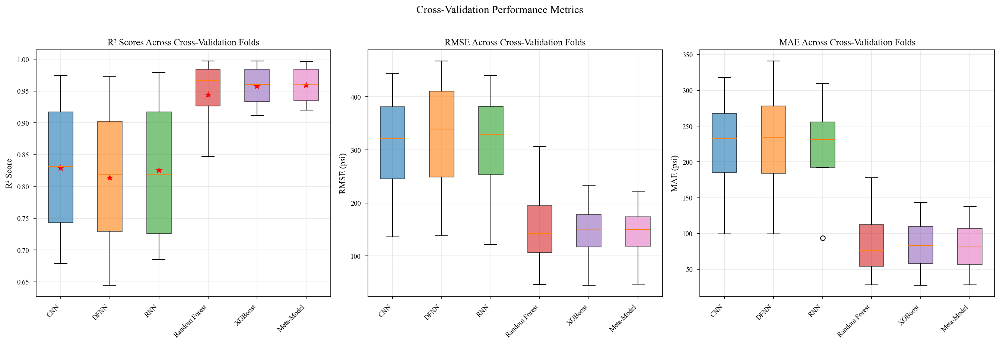


DETAILED FOLD-WISE R² SCORES
 Fold       Test Well    CNN   DFNN    RNN Random Forest XGBoost Meta-Model
    1       QAZIAN-1X 0.8982 0.8790 0.8966        0.9804  0.9799     0.9804
    2 MISSA_KESWAL-01 0.9742 0.9734 0.9793        0.9970  0.9972     0.9969
    3 MISSA_KESWAL-02 0.6786 0.6449 0.6853        0.8473  0.9113     0.9199
    4 MISSA_KESWAL-03 0.7647 0.7574 0.7395        0.9526  0.9407     0.9397


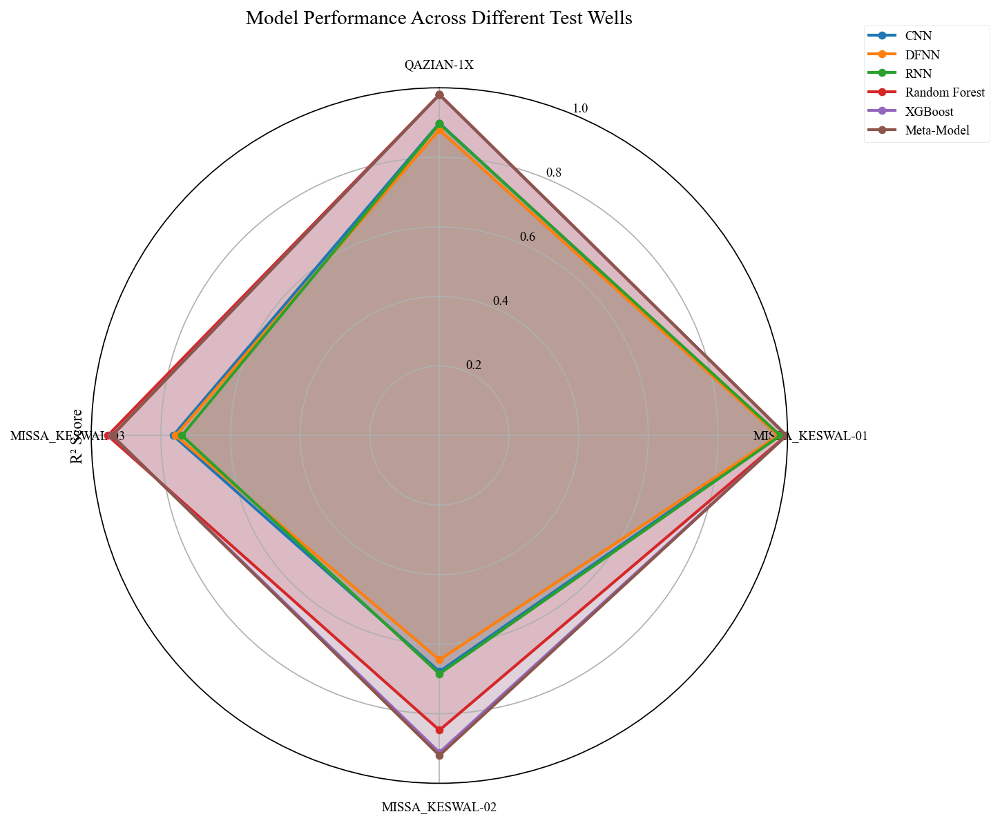


CROSS-VALIDATION COMPLETE!

Total folds completed: 4
Best average performer: Meta-Model
Most consistent model (lowest R² std): Meta-Model

STATISTICAL SIGNIFICANCE TEST (Paired t-test)
Meta-Model vs CNN            : t= 3.113, p=0.0358 *
Meta-Model vs DFNN           : t= 3.200, p=0.0329 *
Meta-Model vs RNN            : t= 3.071, p=0.0372 *
Meta-Model vs Random Forest  : t= 0.774, p=0.4821 ns
Meta-Model vs XGBoost        : t= 0.930, p=0.4052 ns

Significance levels: *** p<0.001, ** p<0.01, * p<0.05, ns: not significant

✅ Cross-validation analysis complete! Results saved to CSV files.


In [21]:
# ============================================
# CROSS-VALIDATION IMPLEMENTATION
# Leave-One-Well-Out Cross-Validation (LOWO-CV)
# ============================================

import pandas as pd
import numpy as np
import csv
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from tensorflow.keras.models import Sequential, clone_model
from tensorflow.keras.layers import (
    Input, Conv1D, BatchNormalization, MaxPooling1D,
    Dropout, Flatten, Dense, LSTM, GRU
)
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from sklearn.ensemble import RandomForestRegressor
import joblib
import xgboost as xgb
from tensorflow.keras import regularizers
from sklearn.linear_model import Ridge
import warnings
warnings.filterwarnings('ignore')

# Set random seeds for reproducibility
np.random.seed(42)
import tensorflow as tf
tf.random.set_seed(42)

print("=" * 80)
print("LEAVE-ONE-WELL-OUT CROSS-VALIDATION")
print("=" * 80)

# Define all wells
all_wells = {
    'QAZIAN-1X': 'C:\Geo\QAZIAN -1X.CSV',
    'MISSA_KESWAL-01': 'C:\Geo\MISSA KESWAL-01.CSV',
    'MISSA_KESWAL-02': 'C:\Geo\MISSA KESWAL-02.CSV',
    'MISSA_KESWAL-03': 'C:\Geo\MISSA KESWAL-03.CSV'
}

# Features and target
features = ['gr', 'dt', 'dt_nct', 'rhob_combined', 'res_deep', 'hp', 'ob', 'sphi']
target_col = 'ppp'
depth_col = 'depth'

# Initialize storage for cross-validation results
cv_results = {
    'CNN': {'r2': [], 'rmse': [], 'mae': []},
    'DFNN': {'r2': [], 'rmse': [], 'mae': []},
    'RNN': {'r2': [], 'rmse': [], 'mae': []},
    'Random Forest': {'r2': [], 'rmse': [], 'mae': []},
    'XGBoost': {'r2': [], 'rmse': [], 'mae': []},
    'Meta-Model': {'r2': [], 'rmse': [], 'mae': []}
}

cv_results_before_ft = {
    'CNN': {'r2': [], 'rmse': [], 'mae': []},
    'DFNN': {'r2': [], 'rmse': [], 'mae': []},
    'RNN': {'r2': [], 'rmse': [], 'mae': []},
    'Random Forest': {'r2': [], 'rmse': [], 'mae': []},
    'XGBoost': {'r2': [], 'rmse': [], 'mae': []}
}

# Store predictions for ensemble analysis
all_fold_predictions = []

# Function to create CNN model
def create_cnn_model(input_shape):
    model = Sequential([
        Input(input_shape),
        Conv1D(64, kernel_size=2, padding='same', activation='relu',
               kernel_regularizer=regularizers.L2(0.001)),
        BatchNormalization(),
        MaxPooling1D(pool_size=2),
        Dropout(0.25),
        Conv1D(128, kernel_size=2, padding='same', activation='relu',
               kernel_regularizer=regularizers.L2(0.001)),
        BatchNormalization(),
        Dropout(0.25),
        Flatten(),
        Dense(128, activation='relu', kernel_regularizer=regularizers.L2(0.002)),
        BatchNormalization(),
        Dropout(0.4),
        Dense(64, activation='relu', kernel_regularizer=regularizers.L2(0.002)),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    return model

# Function to create DFNN model
def create_dfnn_model(input_shape):
    model = Sequential([
        Dense(256, activation='relu', input_shape=(input_shape,)),
        BatchNormalization(),
        Dropout(0.2),
        Dense(128, activation='relu'),
        BatchNormalization(),
        Dropout(0.2),
        Dense(64, activation='relu'),
        BatchNormalization(),
        Dropout(0.1),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    return model

# Function to create RNN model
def create_rnn_model(input_shape):
    model = Sequential([
        Input(input_shape),
        LSTM(64, return_sequences=True),
        BatchNormalization(),
        Dropout(0.3),
        LSTM(32, return_sequences=False),
        BatchNormalization(),
        Dropout(0.3),
        Dense(64, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    return model

# Cross-validation loop
fold_num = 1
for test_well_name, test_well_path in all_wells.items():
    print(f"\n{'='*60}")
    print(f"FOLD {fold_num}: Testing on {test_well_name}")
    print(f"{'='*60}")
    
    # Prepare training wells (all except test well)
    train_wells = {k: v for k, v in all_wells.items() if k != test_well_name}
    
    print(f"\nTraining wells: {list(train_wells.keys())}")
    print(f"Test well: {test_well_name}")
    
    # Load training data
    train_dfs = []
    for well_name, well_path in train_wells.items():
        df = load_and_clean_data(well_path)
        print(f"  {well_name}: {len(df)} samples")
        train_dfs.append(df)
    
    # Load test well
    test_df = load_and_clean_data(test_well_path)
    print(f"\nTest well {test_well_name}: {len(test_df)} samples")
    
    # Combine training data
    train_df_combined = pd.concat(train_dfs, ignore_index=True)
    print(f"Total training samples: {len(train_df_combined)}")
    
    # Apply distribution alignment (using your existing DistributionAligner)
    aligner = DistributionAligner('quantile')  # Using quantile as it performed best
    train_df_aligned = aligner.fit_transform(train_df_combined, features)
    train_df_aligned[target_col] = train_df_combined[target_col]
    train_df_aligned[depth_col] = train_df_combined[depth_col]
    
    test_df_aligned = aligner.transform(test_df, features)
    test_df_aligned[target_col] = test_df[target_col]
    test_df_aligned[depth_col] = test_df[depth_col]
    
    # Split data for training and validation
    train_data, val_data = train_test_split(train_df_aligned, test_size=0.3, random_state=42)
    
    # Split test well for fine-tuning (15%) and final testing (85%)
    df_finetune, df_test_final = train_test_split(test_df_aligned, test_size=0.85, random_state=42)
    
    # Prepare data arrays
    X_train = train_data[features].values
    y_train = train_data[target_col].values
    X_val = val_data[features].values
    y_val = val_data[target_col].values
    
    X_ft = df_finetune[features].values
    y_ft = df_finetune[target_col].values
    X_test = df_test_final[features].values
    y_test = df_test_final[target_col].values
    
    # Scale features
    scaler = StandardScaler()
    X_train_s = scaler.fit_transform(X_train)
    X_val_s = scaler.transform(X_val)
    X_ft_s = scaler.transform(X_ft)
    X_test_s = scaler.transform(X_test)
    
    # Reshape for CNN/RNN
    X_train_cnn = X_train_s.reshape(-1, len(features), 1)
    X_val_cnn = X_val_s.reshape(-1, len(features), 1)
    X_ft_cnn = X_ft_s.reshape(-1, len(features), 1)
    X_test_cnn = X_test_s.reshape(-1, len(features), 1)
    
    X_train_rnn = X_train_s.reshape(-1, len(features), 1)
    X_val_rnn = X_val_s.reshape(-1, len(features), 1)
    X_ft_rnn = X_ft_s.reshape(-1, len(features), 1)
    X_test_rnn = X_test_s.reshape(-1, len(features), 1)
    
    # Callbacks
    es = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    rlr = ReduceLROnPlateau(monitor='val_loss', patience=5, factor=0.5, min_lr=1e-6)
    
    print(f"\n--- Training Models for Fold {fold_num} ---")
    
    # Train CNN
    print("Training CNN...")
    cnn = create_cnn_model((len(features), 1))
    cnn.fit(X_train_cnn, y_train,
            validation_data=(X_val_cnn, y_val),
            epochs=100, batch_size=32,
            callbacks=[es, rlr],
            verbose=0)
    
    # Evaluate before fine-tuning
    y_pred_cnn_before = cnn.predict(X_test_cnn, verbose=0).flatten()
    r2_before = r2_score(y_test, y_pred_cnn_before)
    cv_results_before_ft['CNN']['r2'].append(r2_before)
    
    # Fine-tune CNN
    cnn_ft = clone_model(cnn)
    cnn_ft.set_weights(cnn.get_weights())
    cnn_ft.compile(optimizer='adam', loss='mse')
    cnn_ft.fit(X_ft_cnn, y_ft,
               validation_data=(X_test_cnn, y_test),
               epochs=50, batch_size=16,
               callbacks=[es], verbose=0)
    
    y_pred_cnn = cnn_ft.predict(X_test_cnn, verbose=0).flatten()
    
    # Train DFNN
    print("Training DFNN...")
    dfnn = create_dfnn_model(len(features))
    dfnn.fit(X_train_s, y_train,
             validation_data=(X_val_s, y_val),
             epochs=100, batch_size=32,
             callbacks=[es, rlr],
             verbose=0)
    
    # Evaluate before fine-tuning
    y_pred_dfnn_before = dfnn.predict(X_test_s, verbose=0).flatten()
    r2_before = r2_score(y_test, y_pred_dfnn_before)
    cv_results_before_ft['DFNN']['r2'].append(r2_before)
    
    # Fine-tune DFNN
    dfnn_ft = clone_model(dfnn)
    dfnn_ft.set_weights(dfnn.get_weights())
    dfnn_ft.compile(optimizer='adam', loss='mse')
    dfnn_ft.fit(X_ft_s, y_ft,
                validation_data=(X_test_s, y_test),
                epochs=50, batch_size=16,
                callbacks=[es], verbose=0)
    
    y_pred_dfnn = dfnn_ft.predict(X_test_s, verbose=0).flatten()
    
    # Train RNN
    print("Training RNN...")
    rnn = create_rnn_model((len(features), 1))
    rnn.fit(X_train_rnn, y_train,
            validation_data=(X_val_rnn, y_val),
            epochs=100, batch_size=16,
            callbacks=[es, rlr],
            verbose=0)
    
    # Evaluate before fine-tuning
    y_pred_rnn_before = rnn.predict(X_test_rnn, verbose=0).flatten()
    r2_before = r2_score(y_test, y_pred_rnn_before)
    cv_results_before_ft['RNN']['r2'].append(r2_before)
    
    # Fine-tune RNN
    rnn_ft = clone_model(rnn)
    rnn_ft.set_weights(rnn.get_weights())
    rnn_ft.compile(optimizer='adam', loss='mse')
    rnn_ft.fit(X_ft_rnn, y_ft,
               validation_data=(X_test_rnn, y_test),
               epochs=50, batch_size=16,
               callbacks=[es], verbose=0)
    
    y_pred_rnn = rnn_ft.predict(X_test_rnn, verbose=0).flatten()
    
    # Train Random Forest
    print("Training Random Forest...")
    rf = RandomForestRegressor(
        n_estimators=500, max_depth=15,
        min_samples_split=5, min_samples_leaf=2,
        random_state=42, n_jobs=-1
    )
    rf.fit(X_train_s, y_train)
    
    # Evaluate before fine-tuning
    y_pred_rf_before = rf.predict(X_test_s)
    r2_before = r2_score(y_test, y_pred_rf_before)
    cv_results_before_ft['Random Forest']['r2'].append(r2_before)
    
    # Fine-tune RF
    rf_ft = RandomForestRegressor(
        n_estimators=500, max_depth=15,
        min_samples_split=5, min_samples_leaf=2,
        random_state=42, n_jobs=-1
    )
    rf_ft.fit(X_ft_s, y_ft)
    y_pred_rf = rf_ft.predict(X_test_s)
    
    # Train XGBoost
    print("Training XGBoost...")
    xgb_model = xgb.XGBRegressor(
        n_estimators=1000,
        max_depth=6,
        learning_rate=0.1,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=42,
        early_stopping_rounds=10
    )
    xgb_model.fit(
        X_train_s, y_train,
        eval_set=[(X_val_s, y_val)],
        verbose=False
    )
    
    # Evaluate before fine-tuning
    y_pred_xgb_before = xgb_model.predict(X_test_s)
    r2_before = r2_score(y_test, y_pred_xgb_before)
    cv_results_before_ft['XGBoost']['r2'].append(r2_before)
    
    # Fine-tune XGBoost
    xgb_ft = xgb.XGBRegressor(
        n_estimators=1000,
        max_depth=6,
        learning_rate=0.01,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=42,
        early_stopping_rounds=10
    )
    xgb_ft.fit(
        X_ft_s, y_ft,
        eval_set=[(X_test_s, y_test)],
        verbose=False
    )
    y_pred_xgb = xgb_ft.predict(X_test_s)
    
    # Create Meta-Model
    print("Creating Meta-Model...")
    predictions_ft = np.column_stack([
        cnn_ft.predict(X_ft_cnn, verbose=0).flatten(),
        dfnn_ft.predict(X_ft_s, verbose=0).flatten(),
        rnn_ft.predict(X_ft_rnn, verbose=0).flatten(),
        rf_ft.predict(X_ft_s),
        xgb_ft.predict(X_ft_s)
    ])
    
    # Train stacking model
    stacking_model = Ridge(alpha=1.0)
    stacking_model.fit(predictions_ft, y_ft)
    
    # Make meta-model predictions
    predictions_test = np.column_stack([
        y_pred_cnn,
        y_pred_dfnn,
        y_pred_rnn,
        y_pred_rf,
        y_pred_xgb
    ])
    y_pred_meta = stacking_model.predict(predictions_test)
    
    # Store results
    model_predictions = {
        'CNN': y_pred_cnn,
        'DFNN': y_pred_dfnn,
        'RNN': y_pred_rnn,
        'Random Forest': y_pred_rf,
        'XGBoost': y_pred_xgb,
        'Meta-Model': y_pred_meta
    }
    
    print(f"\n--- Results for Fold {fold_num} (Test Well: {test_well_name}) ---")
    print("-" * 60)
    
    for model_name, y_pred in model_predictions.items():
        r2 = r2_score(y_test, y_pred)
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        mae = mean_absolute_error(y_test, y_pred)
        
        cv_results[model_name]['r2'].append(r2)
        cv_results[model_name]['rmse'].append(rmse)
        cv_results[model_name]['mae'].append(mae)
        
        print(f"{model_name:15} | R²: {r2:.4f} | RMSE: {rmse:.2f} | MAE: {mae:.2f}")
    
    # Store predictions for later analysis
    fold_predictions = {
        'fold': fold_num,
        'test_well': test_well_name,
        'y_true': y_test,
        'predictions': model_predictions
    }
    all_fold_predictions.append(fold_predictions)
    
    fold_num += 1

# ============================================
# CROSS-VALIDATION SUMMARY
# ============================================

print("\n" + "=" * 80)
print("CROSS-VALIDATION SUMMARY (Mean ± Std)")
print("=" * 80)

summary_stats = []

for model_name in cv_results.keys():
    r2_mean = np.mean(cv_results[model_name]['r2'])
    r2_std = np.std(cv_results[model_name]['r2'])
    rmse_mean = np.mean(cv_results[model_name]['rmse'])
    rmse_std = np.std(cv_results[model_name]['rmse'])
    mae_mean = np.mean(cv_results[model_name]['mae'])
    mae_std = np.std(cv_results[model_name]['mae'])
    
    summary_stats.append({
        'Model': model_name,
        'R² (mean ± std)': f"{r2_mean:.4f} ± {r2_std:.4f}",
        'RMSE (mean ± std)': f"{rmse_mean:.2f} ± {rmse_std:.2f}",
        'MAE (mean ± std)': f"{mae_mean:.2f} ± {mae_std:.2f}"
    })
    
    print(f"{model_name:15} | R²: {r2_mean:.4f} ± {r2_std:.4f} | "
          f"RMSE: {rmse_mean:.2f} ± {rmse_std:.2f} | "
          f"MAE: {mae_mean:.2f} ± {mae_std:.2f}")

# Save summary to CSV
summary_df = pd.DataFrame(summary_stats)
summary_df.to_csv('cross_validation_summary.csv', index=False)

# ============================================
# IMPROVEMENT FROM FINE-TUNING
# ============================================

print("\n" + "=" * 80)
print("IMPROVEMENT FROM FINE-TUNING (Average across folds)")
print("=" * 80)

for model_name in ['CNN', 'DFNN', 'RNN', 'Random Forest', 'XGBoost']:
    r2_before_mean = np.mean(cv_results_before_ft[model_name]['r2'])
    r2_after_mean = np.mean(cv_results[model_name]['r2'])
    improvement = r2_after_mean - r2_before_mean
    
    print(f"{model_name:15} | Before: {r2_before_mean:.4f} | "
          f"After: {r2_after_mean:.4f} | Improvement: {improvement:+.4f}")

# ============================================
# VISUALIZATION OF CROSS-VALIDATION RESULTS
# ============================================

# Box plot of R² scores across folds
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# R² scores
ax = axes[0]
r2_data = [cv_results[model]['r2'] for model in cv_results.keys()]
positions = np.arange(len(cv_results.keys()))
bp = ax.boxplot(r2_data, labels=list(cv_results.keys()), patch_artist=True)

for patch, color in zip(bp['boxes'], ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#e377c2']):
    patch.set_facecolor(color)
    patch.set_alpha(0.6)

ax.set_ylabel('R² Score')
ax.set_title('R² Scores Across Cross-Validation Folds')
ax.grid(True, alpha=0.3)
ax.set_xticklabels(list(cv_results.keys()), rotation=45, ha='right')

# Add mean values
for i, model in enumerate(cv_results.keys()):
    mean_val = np.mean(cv_results[model]['r2'])
    ax.plot(i+1, mean_val, 'r*', markersize=10)

# RMSE scores
ax = axes[1]
rmse_data = [cv_results[model]['rmse'] for model in cv_results.keys()]
bp = ax.boxplot(rmse_data, labels=list(cv_results.keys()), patch_artist=True)

for patch, color in zip(bp['boxes'], ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#e377c2']):
    patch.set_facecolor(color)
    patch.set_alpha(0.6)

ax.set_ylabel('RMSE (psi)')
ax.set_title('RMSE Across Cross-Validation Folds')
ax.grid(True, alpha=0.3)
ax.set_xticklabels(list(cv_results.keys()), rotation=45, ha='right')

# MAE scores
ax = axes[2]
mae_data = [cv_results[model]['mae'] for model in cv_results.keys()]
bp = ax.boxplot(mae_data, labels=list(cv_results.keys()), patch_artist=True)

for patch, color in zip(bp['boxes'], ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#e377c2']):
    patch.set_facecolor(color)
    patch.set_alpha(0.6)

ax.set_ylabel('MAE (psi)')
ax.set_title('MAE Across Cross-Validation Folds')
ax.grid(True, alpha=0.3)
ax.set_xticklabels(list(cv_results.keys()), rotation=45, ha='right')

plt.suptitle('Cross-Validation Performance Metrics', fontsize=14, y=1.02)
plt.tight_layout()
plt.savefig('cross_validation_boxplots.png', dpi=300, bbox_inches='tight')
plt.show()

# ============================================
# FOLD-WISE PERFORMANCE TABLE
# ============================================

print("\n" + "=" * 80)
print("DETAILED FOLD-WISE R² SCORES")
print("=" * 80)

# Create detailed results table
detailed_results = []
for i, well_name in enumerate(all_wells.keys()):
    fold_result = {'Fold': i+1, 'Test Well': well_name}
    for model_name in cv_results.keys():
        fold_result[model_name] = f"{cv_results[model_name]['r2'][i]:.4f}"
    detailed_results.append(fold_result)

detailed_df = pd.DataFrame(detailed_results)
print(detailed_df.to_string(index=False))

# Save detailed results
detailed_df.to_csv('fold_wise_results.csv', index=False)

# ============================================
# RADAR CHART FOR MODEL COMPARISON
# ============================================

from math import pi

fig = plt.figure(figsize=(10, 10))

# Number of variables
categories = list(all_wells.keys())
N = len(categories)

# Compute angle for each axis
angles = [n / float(N) * 2 * pi for n in range(N)]
angles += angles[:1]

# Initialize the plot
ax = plt.subplot(111, polar=True)

# Plot data for each model
for model_name in ['CNN', 'DFNN', 'RNN', 'Random Forest', 'XGBoost', 'Meta-Model']:
    values = cv_results[model_name]['r2']
    values += values[:1]  # Complete the circle
    
    ax.plot(angles, values, 'o-', linewidth=2, label=model_name)
    ax.fill(angles, values, alpha=0.15)

# Fix axis to go in the right order
ax.set_theta_offset(pi / 2)
ax.set_theta_direction(-1)

# Draw axis lines for each angle and label
ax.set_xticks(angles[:-1])
ax.set_xticklabels(categories)

# Set y-axis limits and labels
ax.set_ylim(0, 1)
ax.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
ax.set_yticklabels(['0.2', '0.4', '0.6', '0.8', '1.0'])
ax.set_ylabel('R² Score')

# Add legend
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))

plt.title('Model Performance Across Different Test Wells', size=14, y=1.08)
plt.tight_layout()
plt.savefig('radar_chart_well_performance.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n" + "=" * 80)
print("CROSS-VALIDATION COMPLETE!")
print("=" * 80)
print(f"\nTotal folds completed: {len(all_wells)}")
print(f"Best average performer: {max(cv_results.keys(), key=lambda k: np.mean(cv_results[k]['r2']))}")
print(f"Most consistent model (lowest R² std): {min(cv_results.keys(), key=lambda k: np.std(cv_results[k]['r2']))}")

# Statistical significance test (paired t-test between models)
from scipy import stats

print("\n" + "=" * 80)
print("STATISTICAL SIGNIFICANCE TEST (Paired t-test)")
print("=" * 80)

# Compare Meta-Model with each individual model
for model_name in ['CNN', 'DFNN', 'RNN', 'Random Forest', 'XGBoost']:
    t_stat, p_value = stats.ttest_rel(cv_results['Meta-Model']['r2'], 
                                       cv_results[model_name]['r2'])
    
    significance = "***" if p_value < 0.001 else "**" if p_value < 0.01 else "*" if p_value < 0.05 else "ns"
    print(f"Meta-Model vs {model_name:15}: t={t_stat:6.3f}, p={p_value:.4f} {significance}")

print("\nSignificance levels: *** p<0.001, ** p<0.01, * p<0.05, ns: not significant")

print("\n✅ Cross-validation analysis complete! Results saved to CSV files.")